<a href="https://colab.research.google.com/github/purvi0116/Image-Generation-using-cGAN/blob/main/Conditional_GAN_(Student).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [ ]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [ ]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [ ]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels of the output image, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [ ]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    one_hot = torch.nn.functional.one_hot(labels, n_classes)
    return one_hot
    #### END CODE HERE ####

In [ ]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [ ]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(),y.float()),1)
    #### END CODE HERE ####
    return combined

In [ ]:
assert tuple(combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5)).shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [ ]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [ ]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)

/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [ ]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [ ]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [ ]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
# Initialization of model params
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.1636636468172075, discriminator loss: 0.2456842686906457


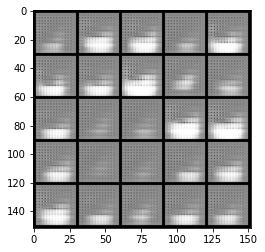

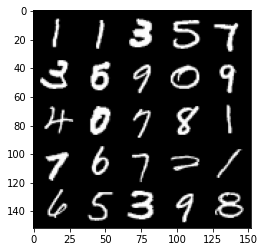

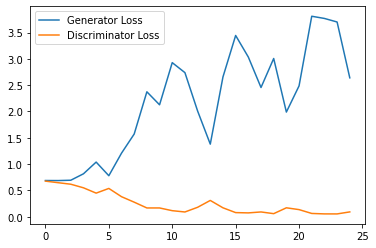

Step 1000: Generator loss: 4.4662703185081485, discriminator loss: 0.0411266026943922


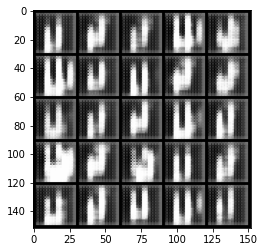

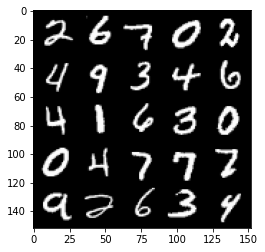

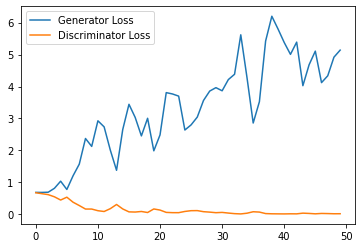

Step 1500: Generator loss: 5.264153777122497, discriminator loss: 0.03042174974642694


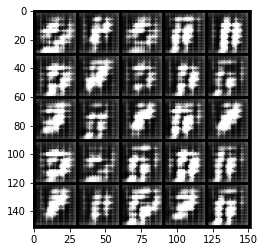

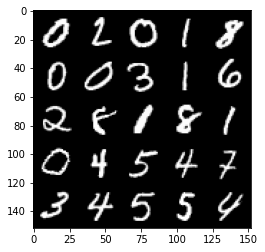

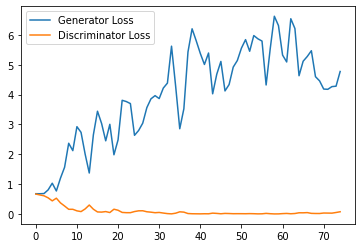

Step 2000: Generator loss: 3.8937857971191407, discriminator loss: 0.07306691015139222


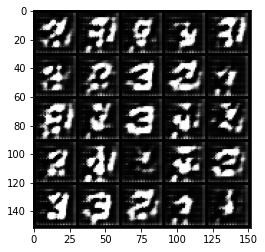

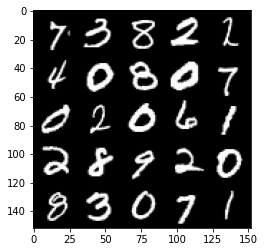

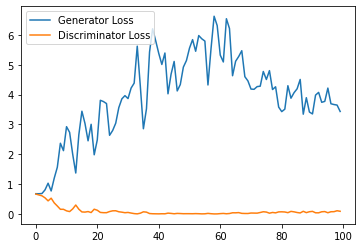

Step 2500: Generator loss: 2.9640870769023895, discriminator loss: 0.17688739132136105


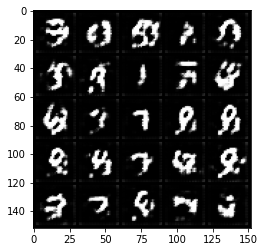

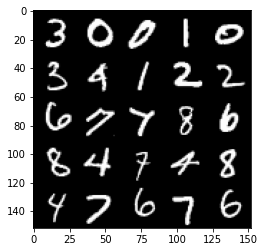

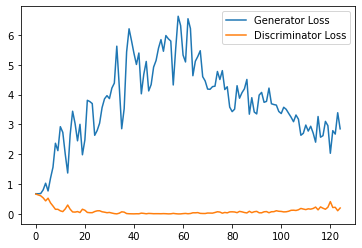

Step 3000: Generator loss: 2.3680374352931977, discriminator loss: 0.283148250117898


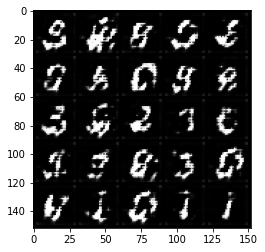

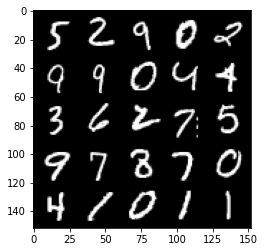

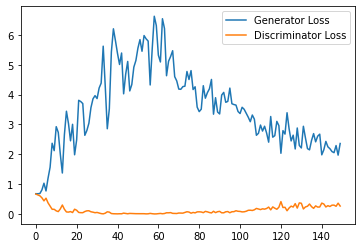

Step 3500: Generator loss: 2.3111727290153503, discriminator loss: 0.2827633935213089


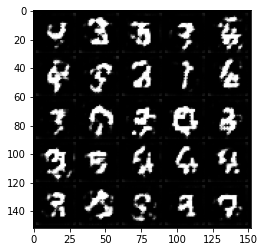

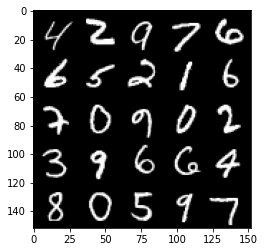

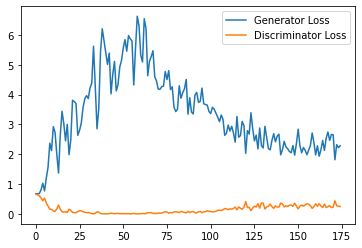

Step 4000: Generator loss: 2.2003377280235292, discriminator loss: 0.30442093235254286


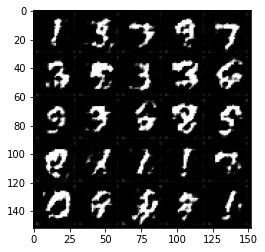

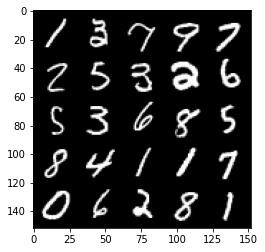

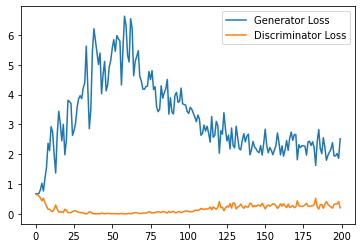

Step 4500: Generator loss: 2.087791685342789, discriminator loss: 0.3039737527668476


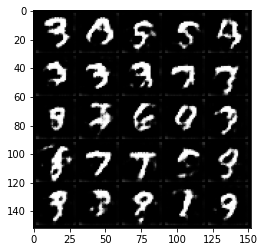

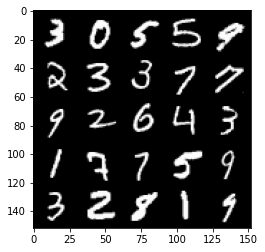

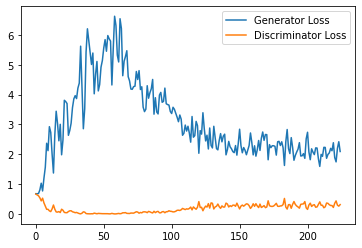

Step 5000: Generator loss: 1.9907007825374603, discriminator loss: 0.339961506575346


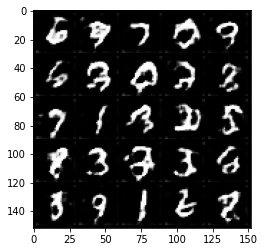

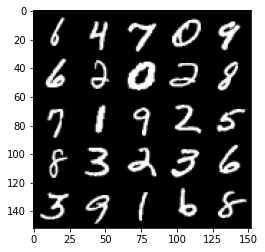

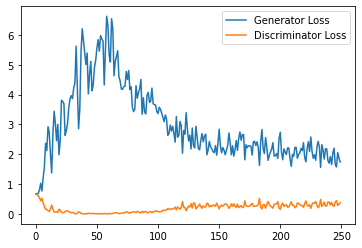

Step 5500: Generator loss: 1.8776005218029022, discriminator loss: 0.3684625032842159


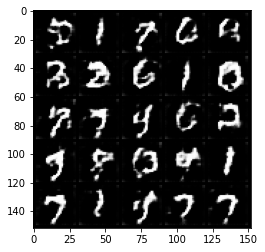

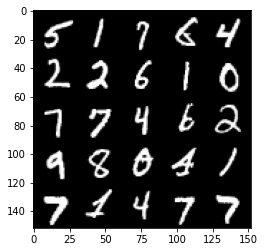

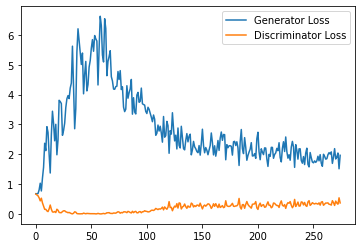

Step 6000: Generator loss: 1.8608584249019622, discriminator loss: 0.38860631895065306


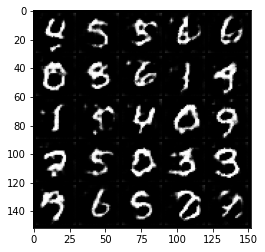

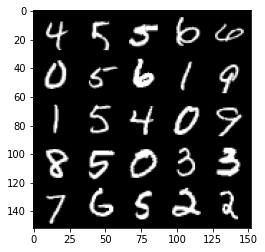

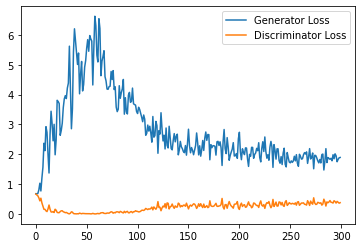

Step 6500: Generator loss: 1.690636536359787, discriminator loss: 0.4141548485159874


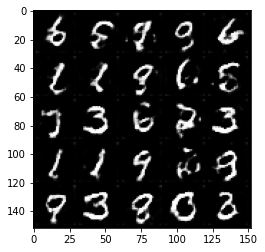

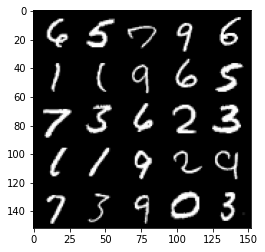

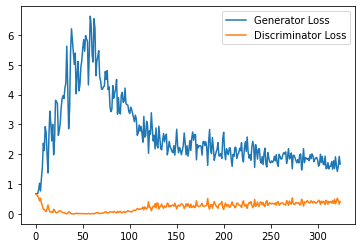

Step 7000: Generator loss: 1.6094528106451034, discriminator loss: 0.42210598587989806


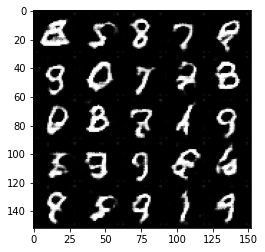

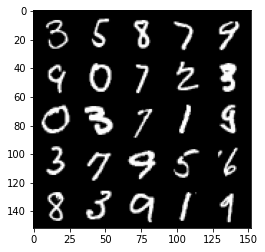

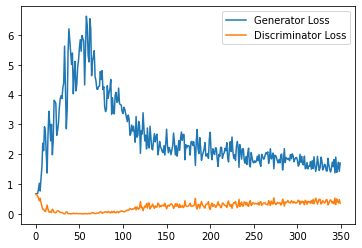

Step 7500: Generator loss: 1.6175210968255997, discriminator loss: 0.45182400405406953


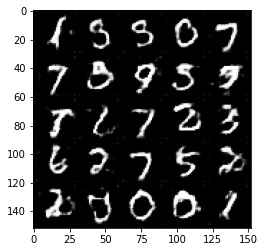

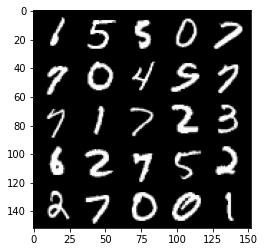

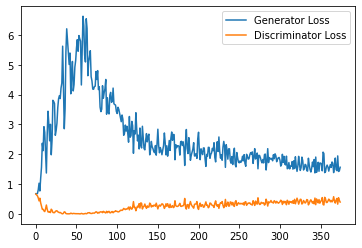

Step 8000: Generator loss: 1.5712194855213166, discriminator loss: 0.4598909680843353


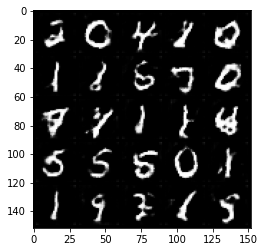

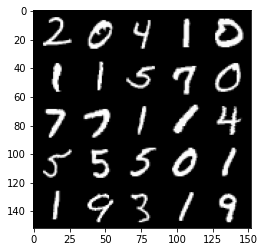

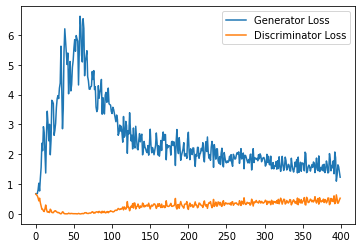

Step 8500: Generator loss: 1.4578901797533035, discriminator loss: 0.467876911342144


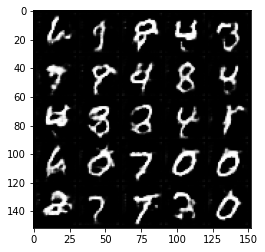

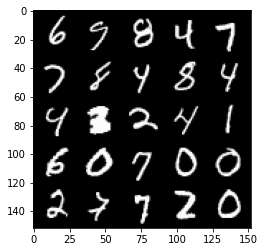

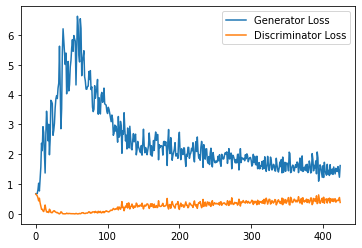

Step 9000: Generator loss: 1.5076059181690216, discriminator loss: 0.47394053119421004


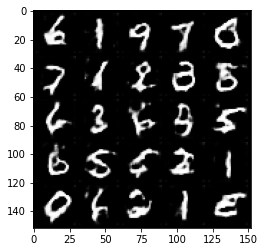

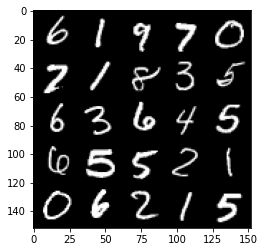

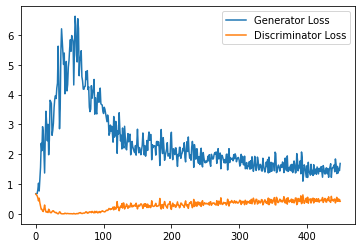

Step 9500: Generator loss: 1.4017418936491013, discriminator loss: 0.48590910029411316


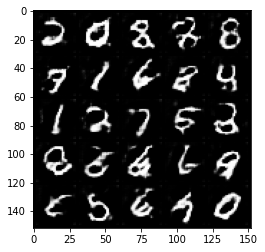

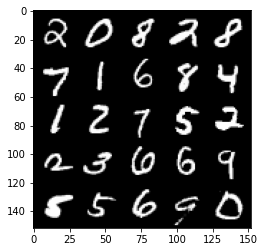

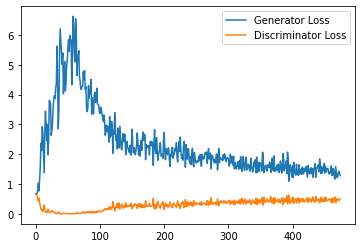

Step 10000: Generator loss: 1.3539381114244462, discriminator loss: 0.49326021361351013


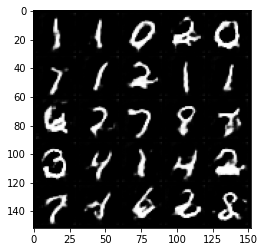

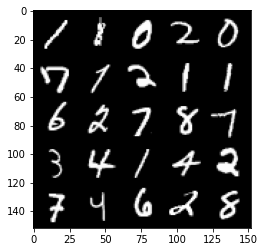

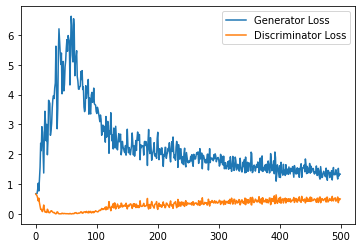

Step 10500: Generator loss: 1.3539509520530701, discriminator loss: 0.4997427693605423


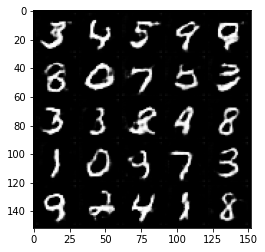

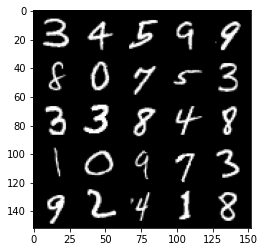

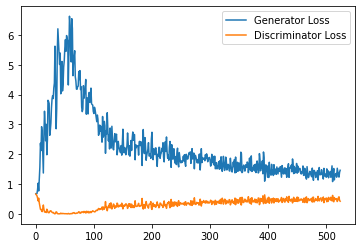

Step 11000: Generator loss: 1.3314005579948425, discriminator loss: 0.5054695212841034


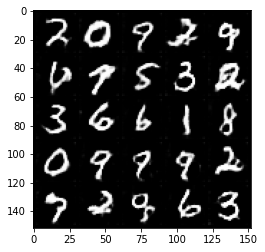

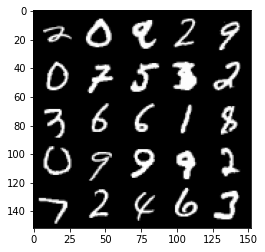

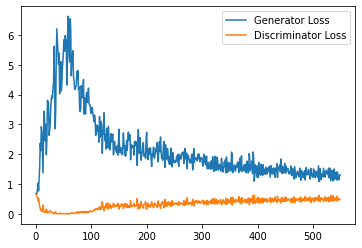

Step 11500: Generator loss: 1.2936083186864853, discriminator loss: 0.5149817878603935


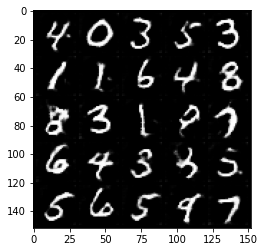

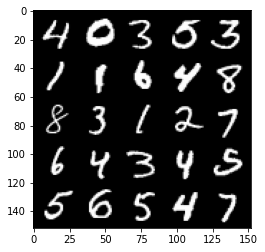

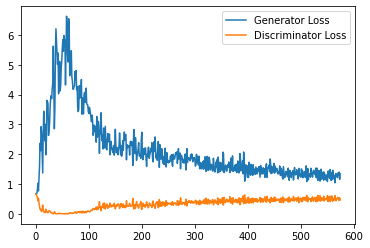

Step 12000: Generator loss: 1.3113759410381318, discriminator loss: 0.5156770312190055


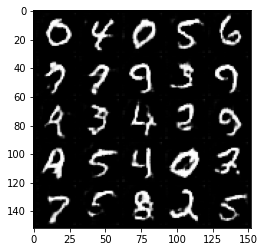

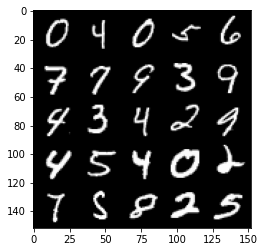

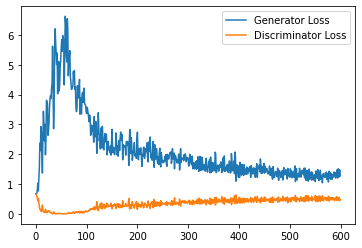

Step 12500: Generator loss: 1.282494039773941, discriminator loss: 0.5196842442154884


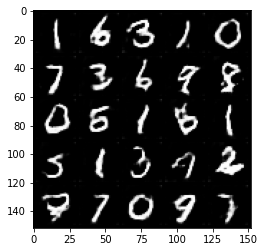

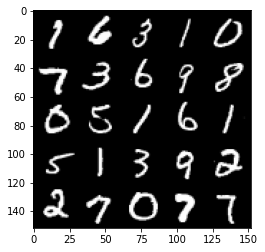

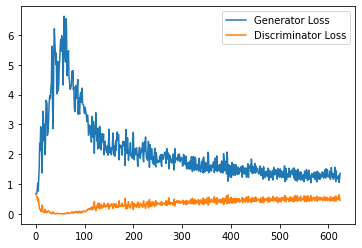

Step 13000: Generator loss: 1.2533758246898652, discriminator loss: 0.5275149322152137


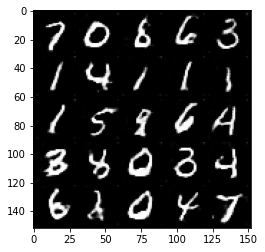

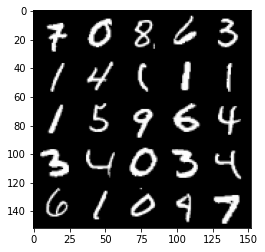

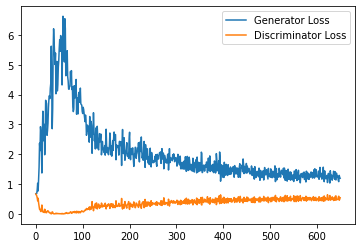

Step 13500: Generator loss: 1.216466992020607, discriminator loss: 0.5347201756834984


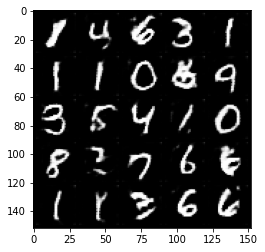

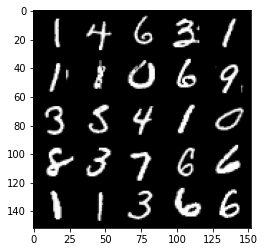

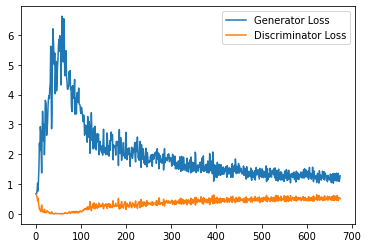

Step 14000: Generator loss: 1.2573253976106644, discriminator loss: 0.5307316134572029


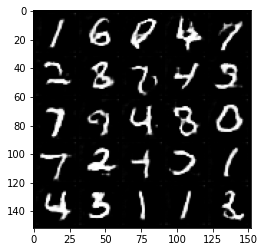

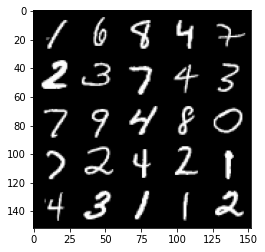

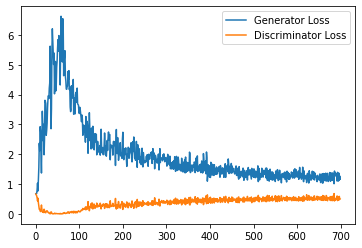

Step 14500: Generator loss: 1.160268554329872, discriminator loss: 0.540087571978569


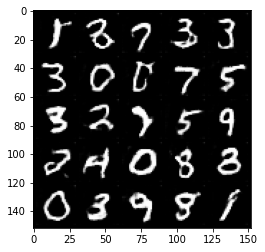

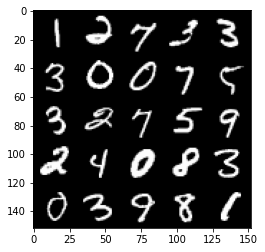

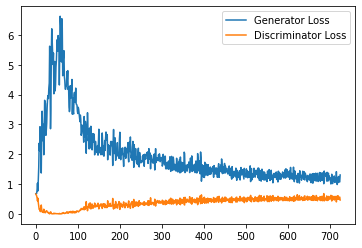

Step 15000: Generator loss: 1.1777258715629577, discriminator loss: 0.5442481219172478


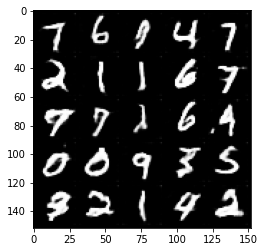

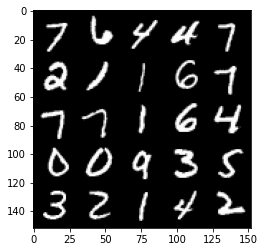

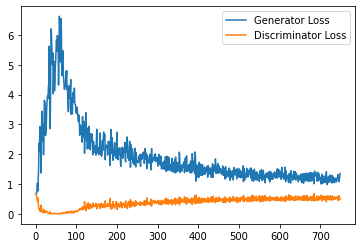

Step 15500: Generator loss: 1.1705805448293687, discriminator loss: 0.5532778319716454


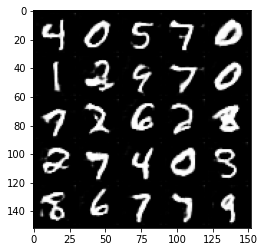

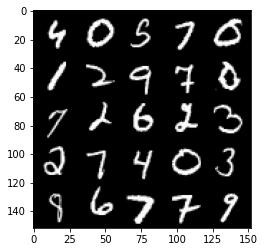

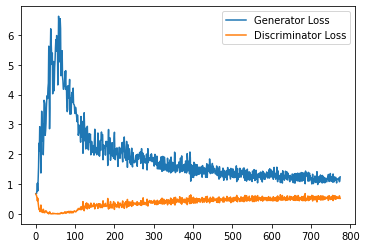

Step 16000: Generator loss: 1.2111042387485504, discriminator loss: 0.5508329839706421


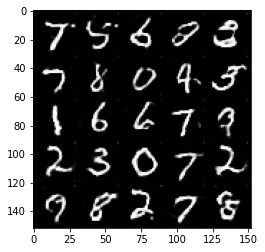

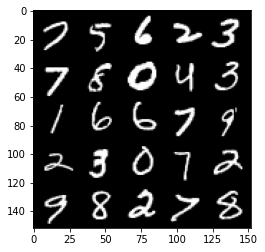

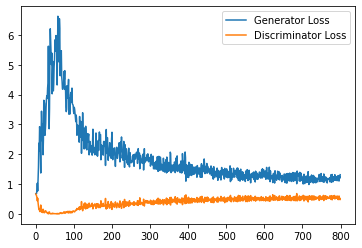

Step 16500: Generator loss: 1.133036922454834, discriminator loss: 0.5594807591438293


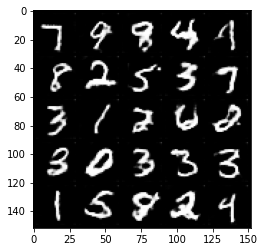

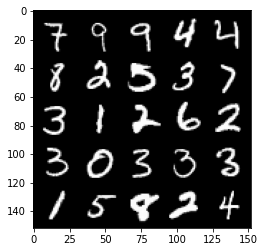

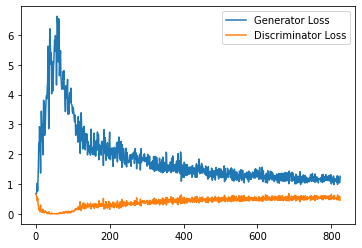

Step 17000: Generator loss: 1.1103523701429368, discriminator loss: 0.5585782185196877


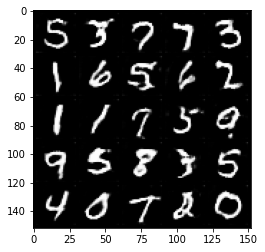

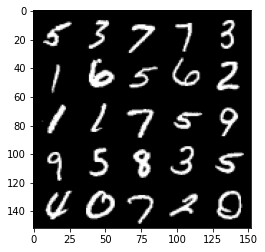

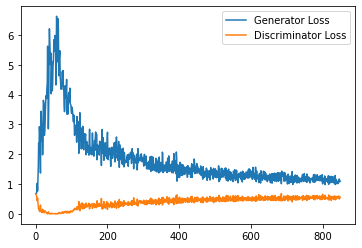

Step 17500: Generator loss: 1.1327289426326752, discriminator loss: 0.5596813948750496


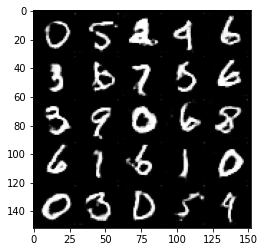

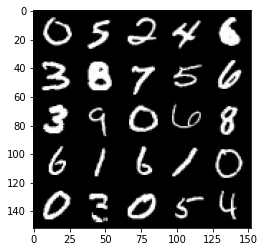

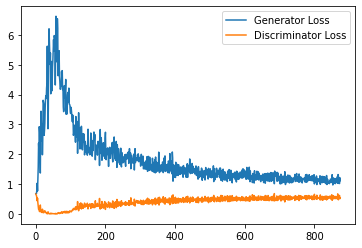

Step 18000: Generator loss: 1.1071456971168518, discriminator loss: 0.5601230119466781


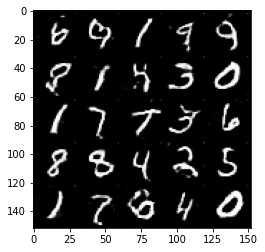

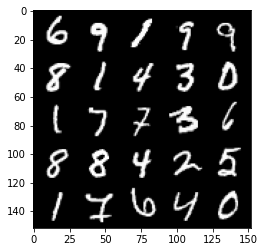

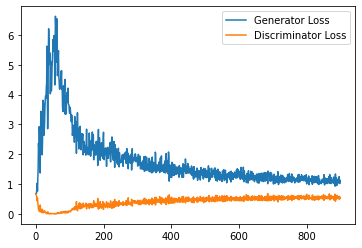

Step 18500: Generator loss: 1.1185011321306229, discriminator loss: 0.5649444169998169


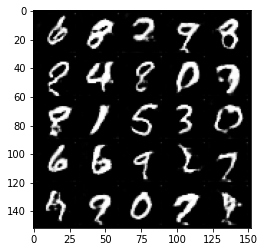

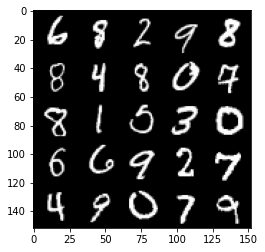

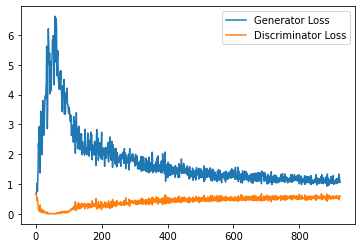

Step 19000: Generator loss: 1.1437610377073288, discriminator loss: 0.5572199168801307


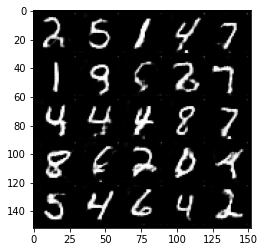

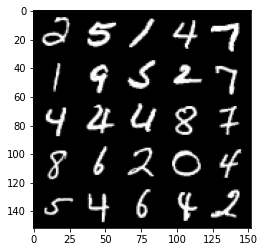

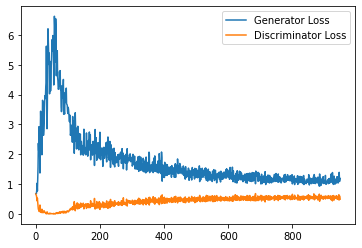

Step 19500: Generator loss: 1.1077041302919388, discriminator loss: 0.5689990832209587


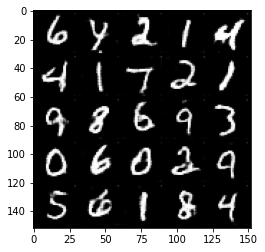

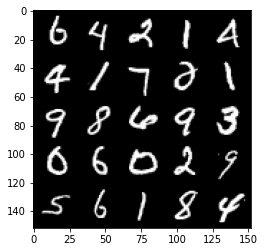

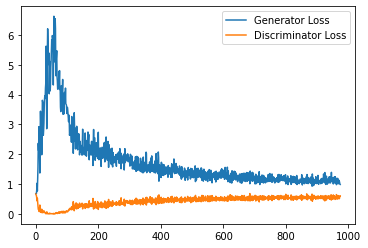

Step 20000: Generator loss: 1.0700281542539596, discriminator loss: 0.5612066524028778


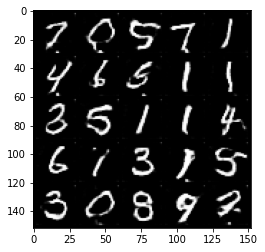

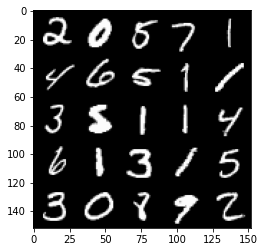

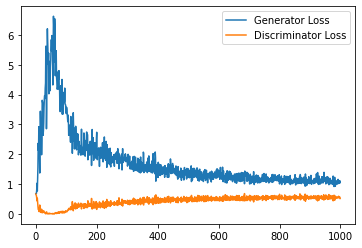

Step 20500: Generator loss: 1.0761319280862809, discriminator loss: 0.5730399611592293


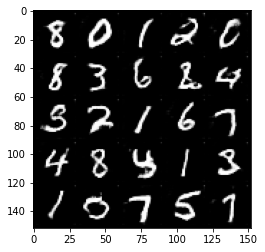

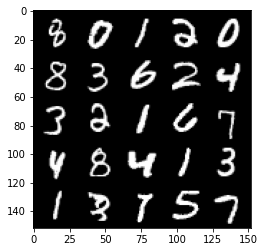

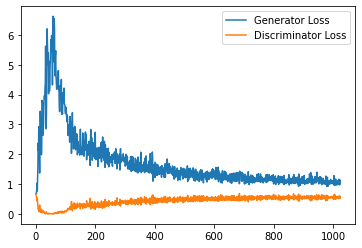

Step 21000: Generator loss: 1.1046485390663148, discriminator loss: 0.5718216317296028


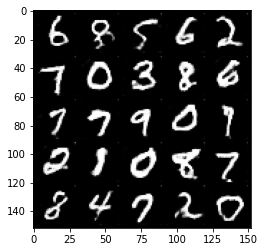

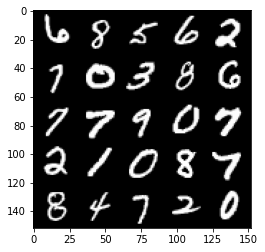

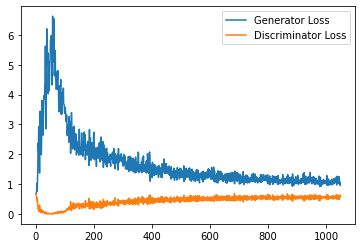

Step 21500: Generator loss: 1.0898089295625686, discriminator loss: 0.5704761469364166


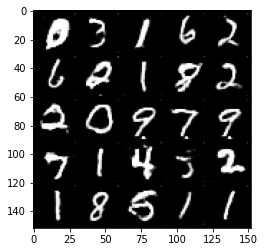

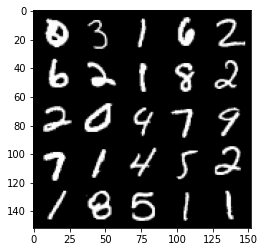

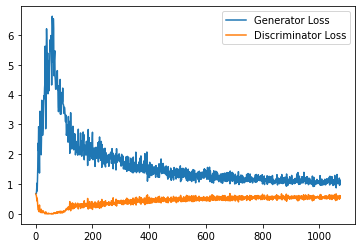

Step 22000: Generator loss: 1.0885122344493865, discriminator loss: 0.576485986828804


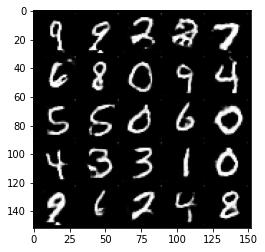

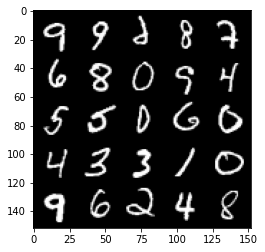

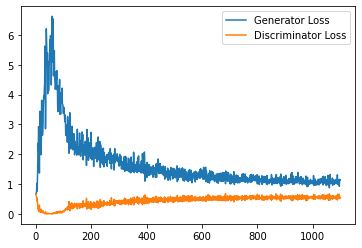

Step 22500: Generator loss: 1.0581717277765275, discriminator loss: 0.5716256318688393


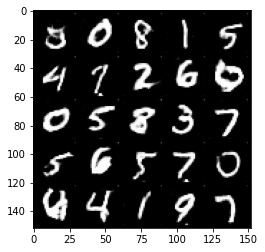

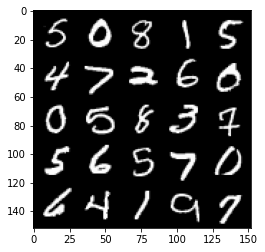

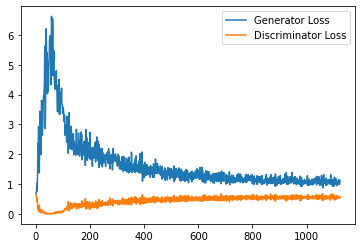

Step 23000: Generator loss: 1.0670161907672882, discriminator loss: 0.5788750613331795


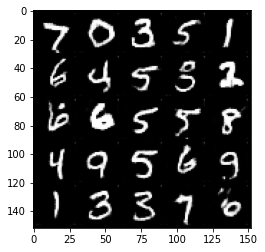

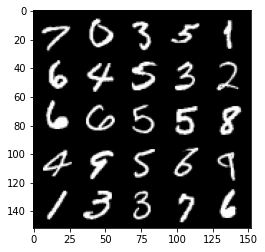

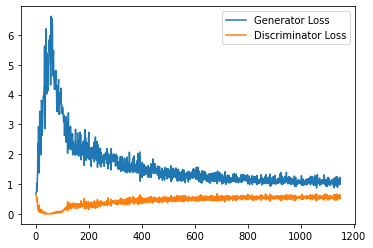

Step 23500: Generator loss: 1.0873450504541398, discriminator loss: 0.5807645646929741


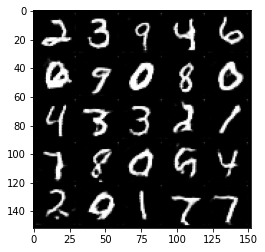

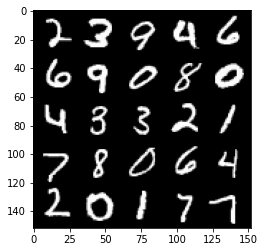

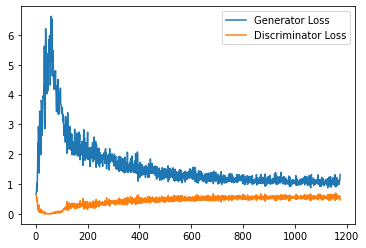

Step 24000: Generator loss: 1.0707969546318055, discriminator loss: 0.5816642625927925


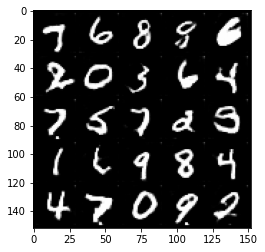

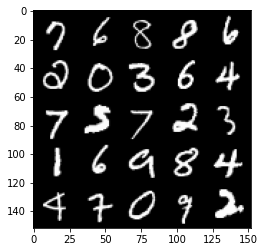

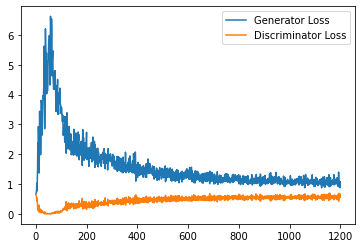

Step 24500: Generator loss: 1.0618580394983292, discriminator loss: 0.571482173204422


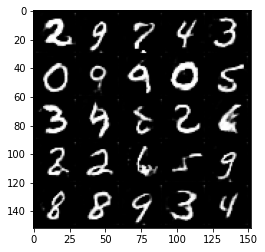

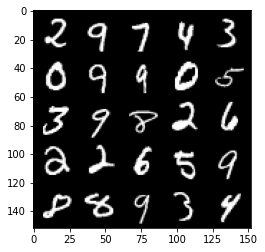

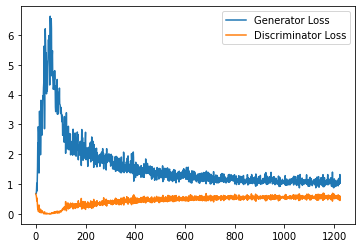

Step 25000: Generator loss: 1.0717398989200593, discriminator loss: 0.5798126621842384


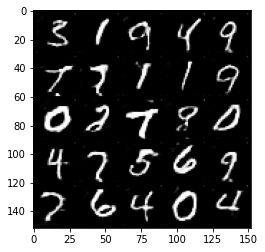

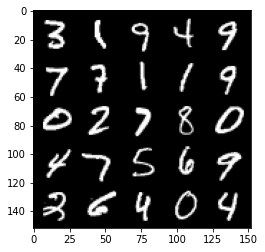

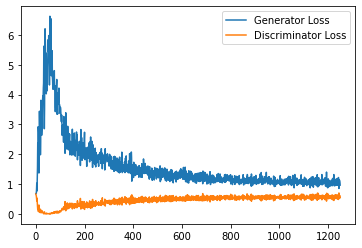

Step 25500: Generator loss: 1.0551602727174758, discriminator loss: 0.5817012955546379


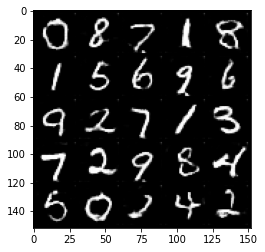

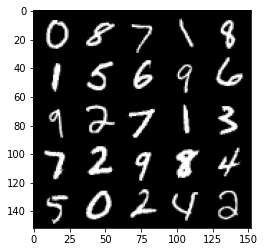

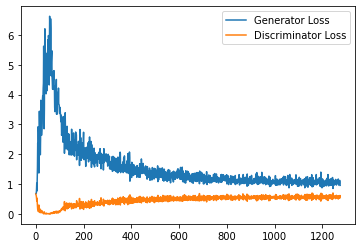

Step 26000: Generator loss: 1.0695496524572372, discriminator loss: 0.575087471485138


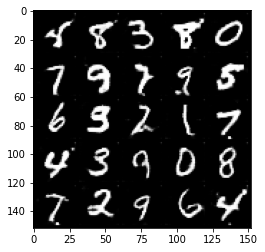

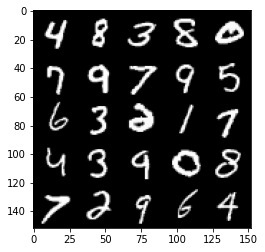

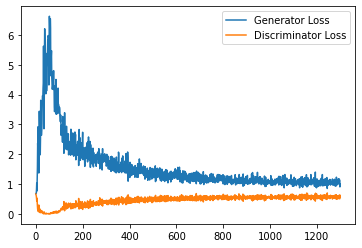

Step 26500: Generator loss: 1.051648978829384, discriminator loss: 0.5763561084270478


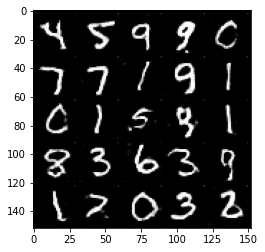

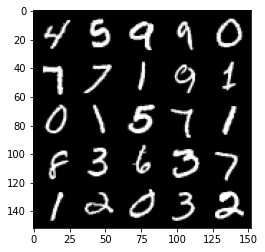

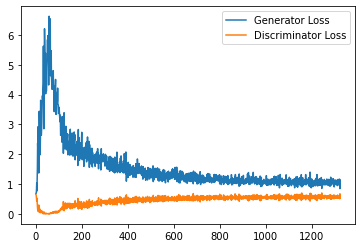

Step 27000: Generator loss: 1.0493345440626145, discriminator loss: 0.5777266685366631


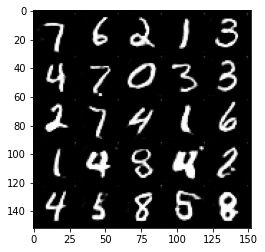

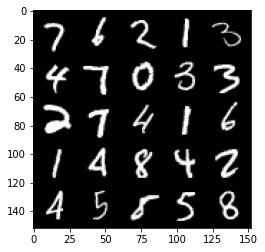

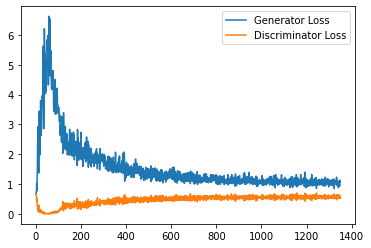

Step 27500: Generator loss: 1.0290648138523102, discriminator loss: 0.5851282938122749


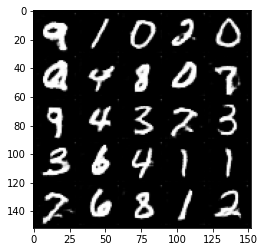

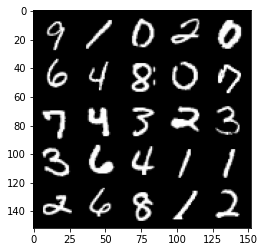

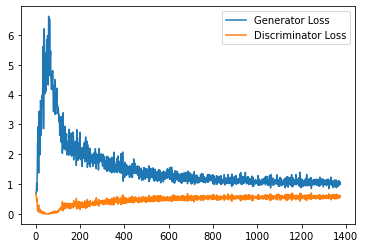

Step 28000: Generator loss: 1.07651648747921, discriminator loss: 0.5778687399625778


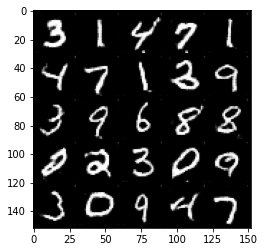

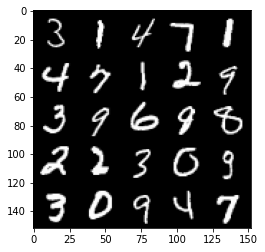

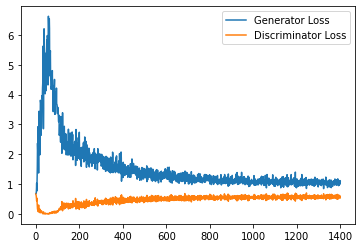

Step 28500: Generator loss: 1.067751495361328, discriminator loss: 0.5805551398992539


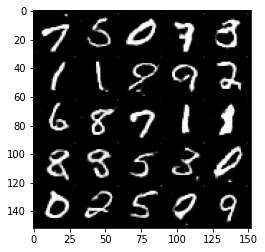

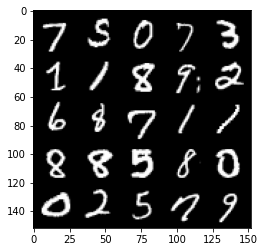

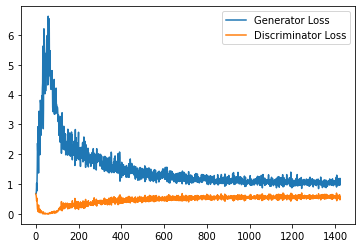

Step 29000: Generator loss: 1.0169180996418, discriminator loss: 0.5859270492196083


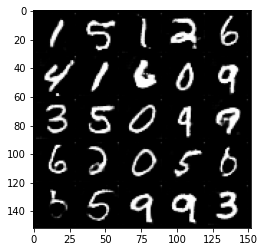

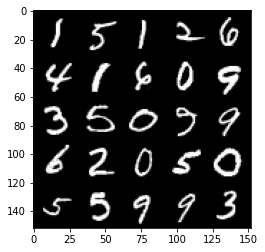

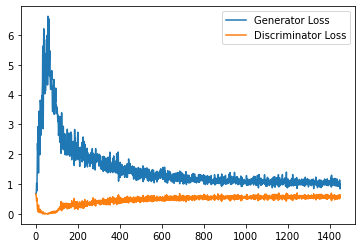

Step 29500: Generator loss: 1.022037450671196, discriminator loss: 0.5800200898051262


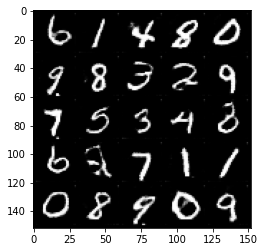

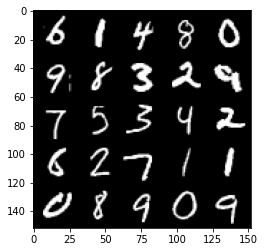

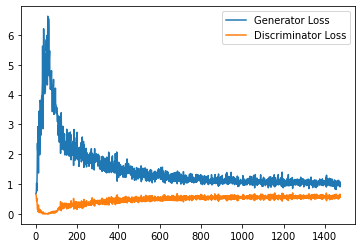

Step 30000: Generator loss: 1.0646222512722014, discriminator loss: 0.5795636086463928


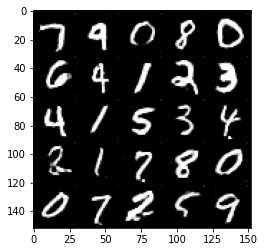

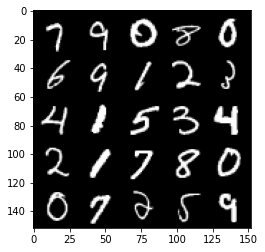

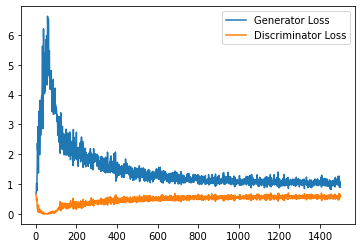

Step 30500: Generator loss: 1.018810424685478, discriminator loss: 0.5777335135936738


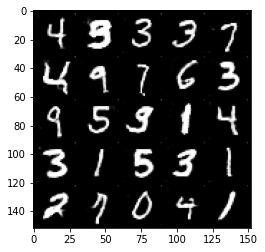

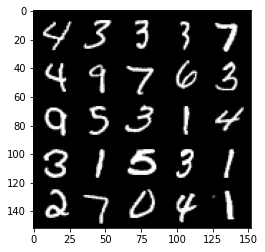

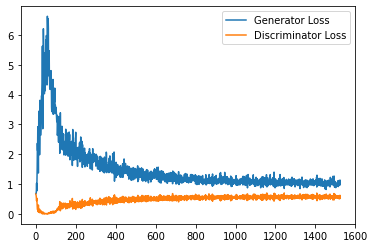

Step 31000: Generator loss: 1.0511729282140732, discriminator loss: 0.5803485310673714


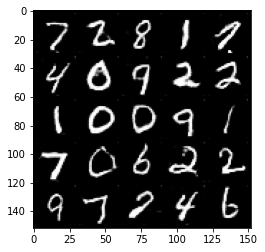

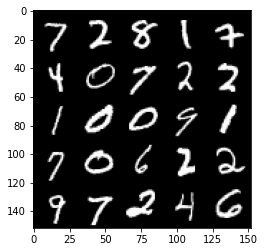

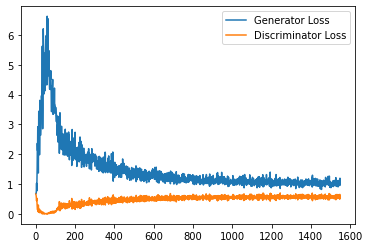

Step 31500: Generator loss: 1.0569671896696091, discriminator loss: 0.5796517575383187


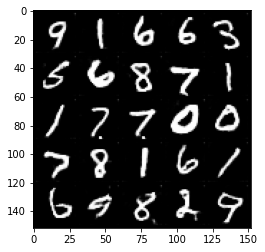

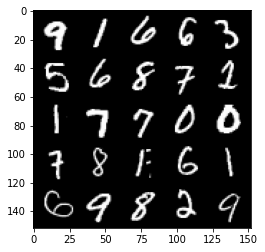

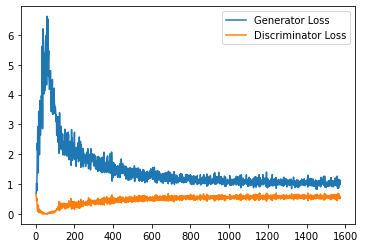

Step 32000: Generator loss: 1.0397020175457001, discriminator loss: 0.5837615991830826


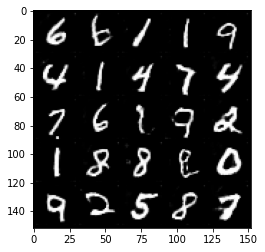

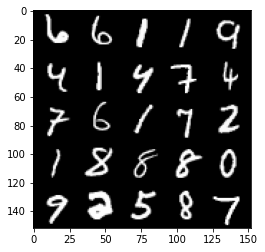

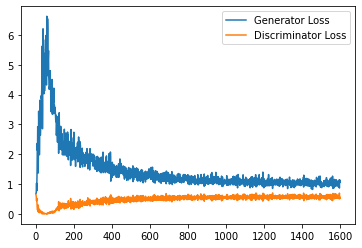

Step 32500: Generator loss: 1.0171658638715744, discriminator loss: 0.589324992120266


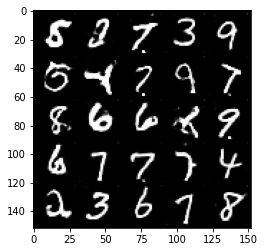

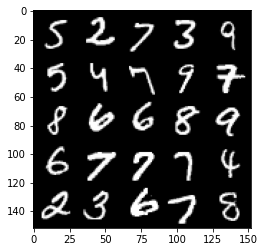

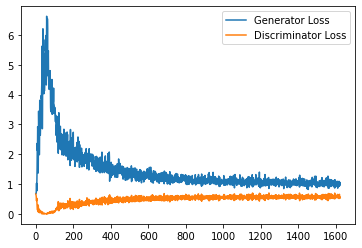

Step 33000: Generator loss: 1.0324041330814362, discriminator loss: 0.5902054159045219


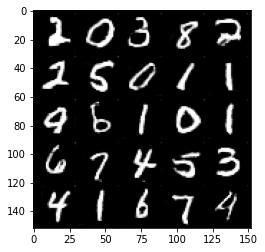

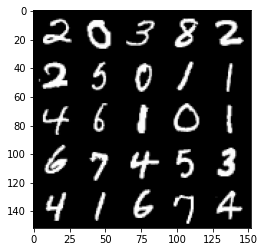

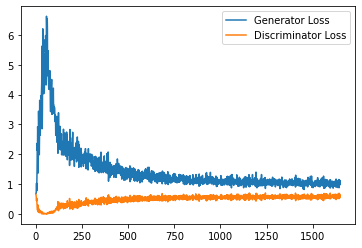

Step 33500: Generator loss: 1.0540450575351714, discriminator loss: 0.5831749560236931


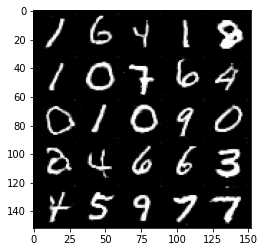

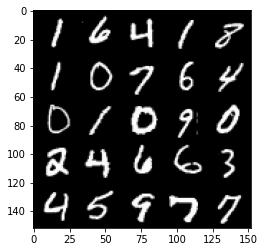

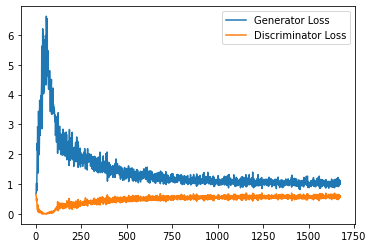

Step 34000: Generator loss: 1.034420352101326, discriminator loss: 0.5763725700974465


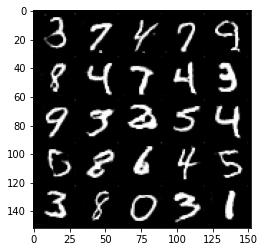

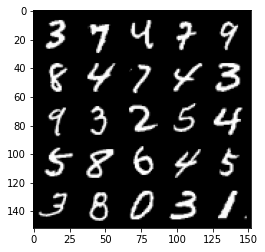

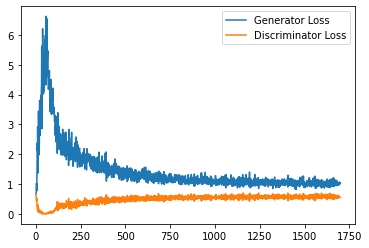

Step 34500: Generator loss: 1.0280796684026718, discriminator loss: 0.5907520371675491


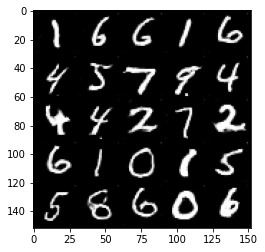

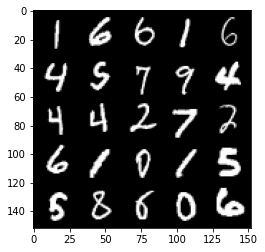

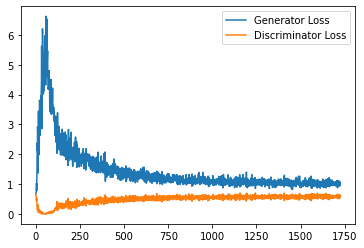

Step 35000: Generator loss: 1.032051079750061, discriminator loss: 0.5898011217713356


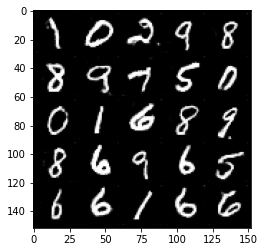

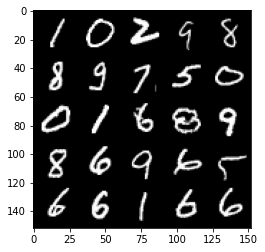

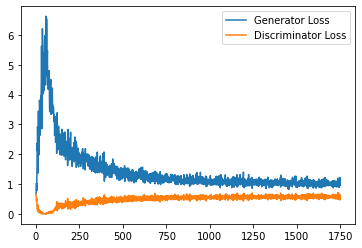

Step 35500: Generator loss: 1.0343104940652847, discriminator loss: 0.5850652565360069


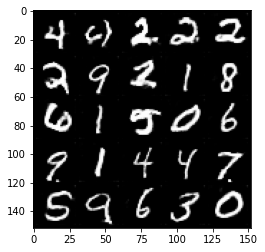

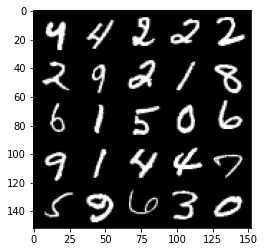

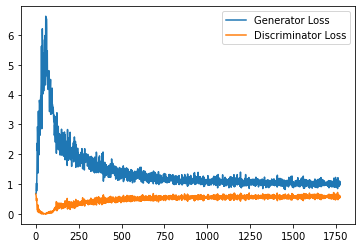

Step 36000: Generator loss: 1.041408077597618, discriminator loss: 0.5821296466588974


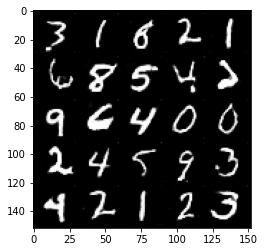

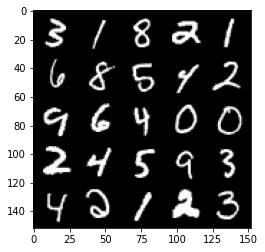

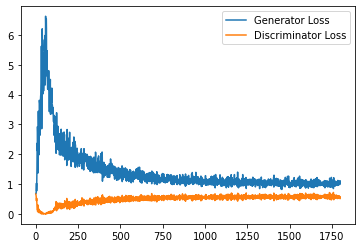

Step 36500: Generator loss: 1.0386582781076432, discriminator loss: 0.586709415614605


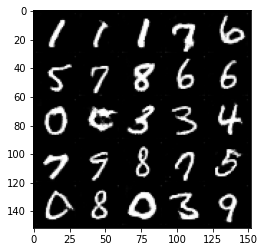

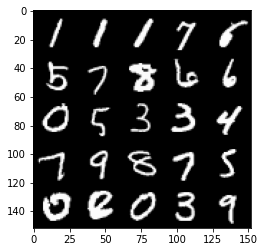

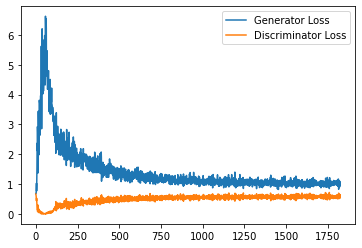

Step 37000: Generator loss: 1.041388053536415, discriminator loss: 0.5847677924036979


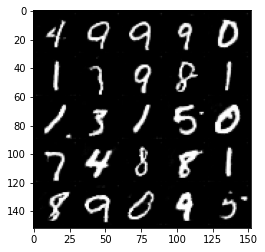

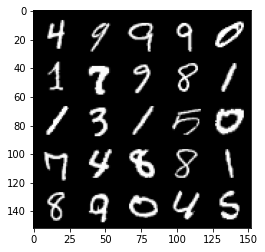

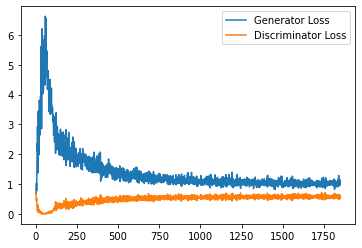

Step 37500: Generator loss: 1.0119027273654937, discriminator loss: 0.5853183766007424


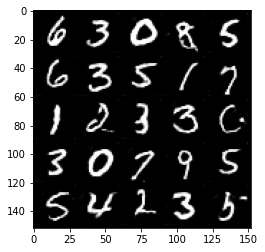

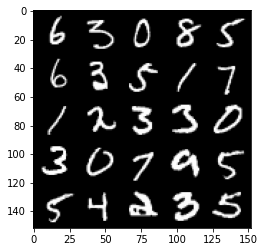

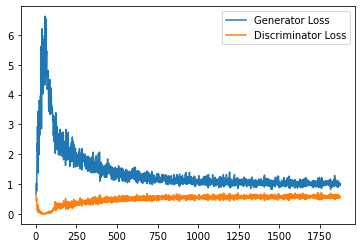

Step 38000: Generator loss: 1.0213481067419052, discriminator loss: 0.5826159640550613


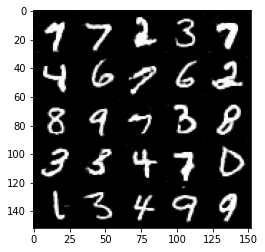

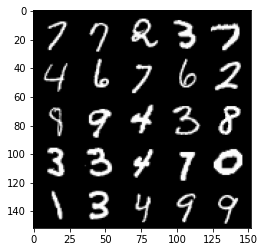

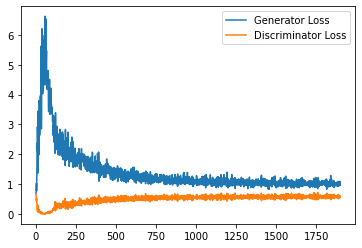

Step 38500: Generator loss: 1.0351674799919128, discriminator loss: 0.5896196501851082


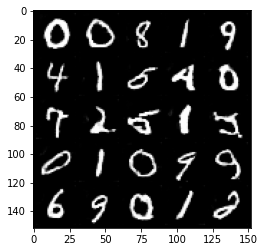

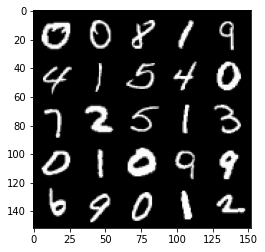

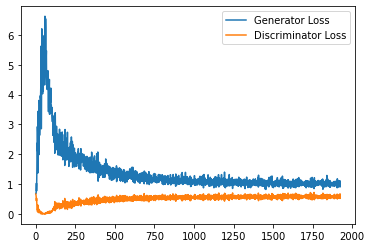

Step 39000: Generator loss: 1.0307428917884827, discriminator loss: 0.5864489379525185


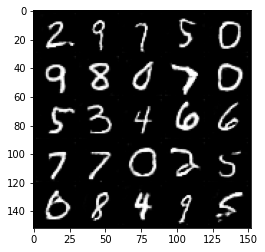

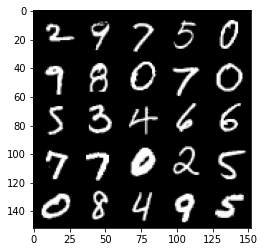

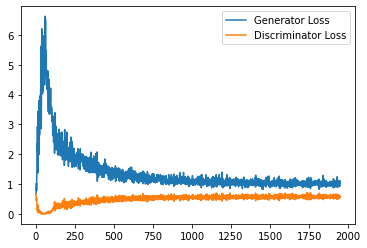

Step 39500: Generator loss: 1.0563901991844178, discriminator loss: 0.5824443795084954


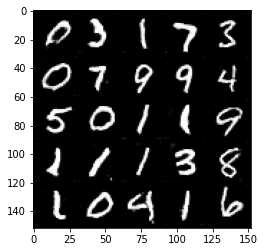

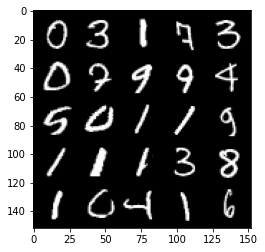

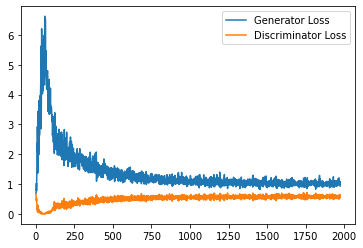

Step 40000: Generator loss: 1.046830644607544, discriminator loss: 0.5826145393848419


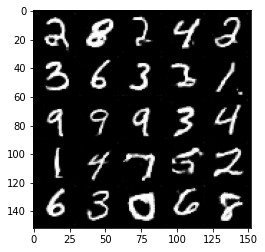

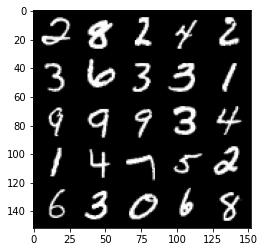

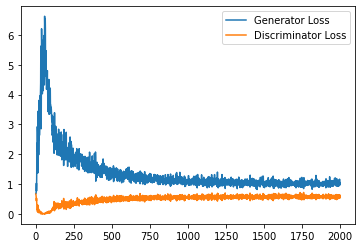

Step 40500: Generator loss: 1.0364234429597854, discriminator loss: 0.5847827288508415


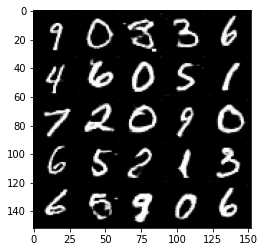

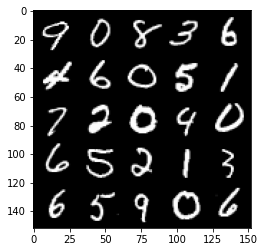

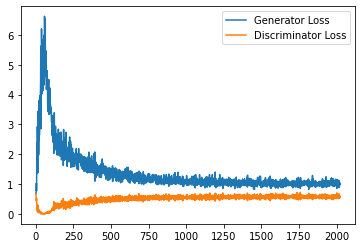

Step 41000: Generator loss: 1.0386915242671966, discriminator loss: 0.583158878326416


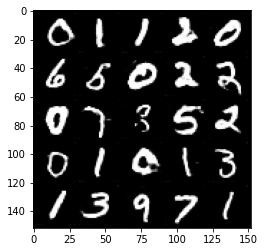

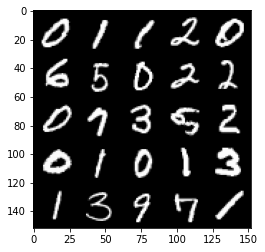

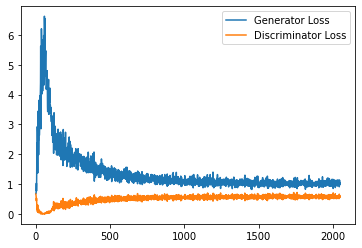

Step 41500: Generator loss: 1.0420737670660019, discriminator loss: 0.5769191935062409


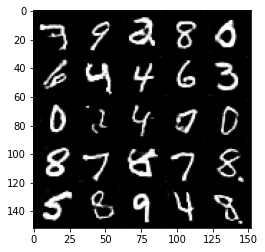

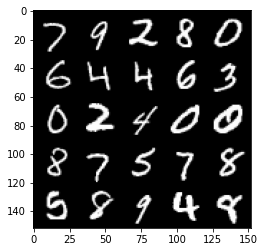

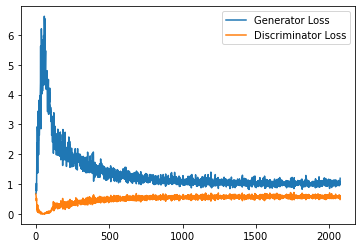

Step 42000: Generator loss: 1.0452842972278595, discriminator loss: 0.5815211403369903


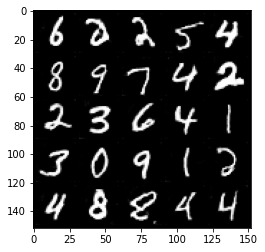

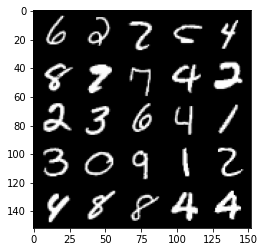

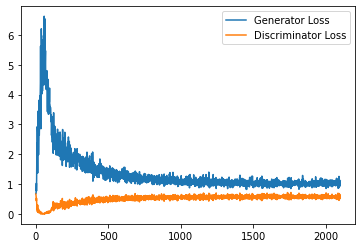

Step 42500: Generator loss: 1.0602586666345597, discriminator loss: 0.5816539872884751


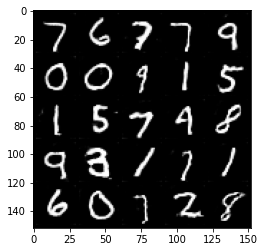

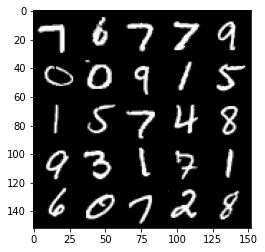

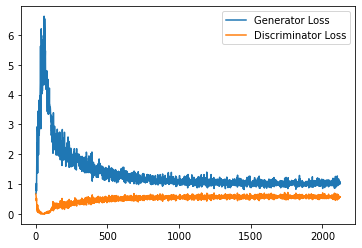

Step 43000: Generator loss: 1.05686211001873, discriminator loss: 0.5753555355668067


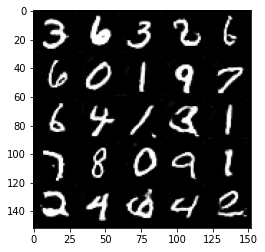

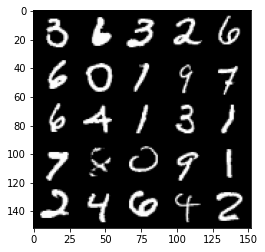

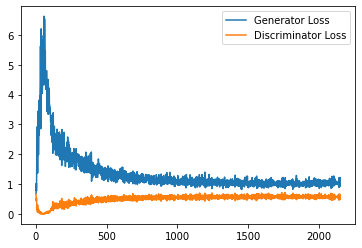

Step 43500: Generator loss: 1.0492717320919036, discriminator loss: 0.5801582914590836


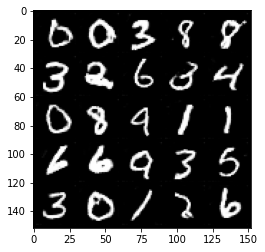

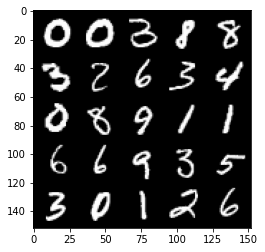

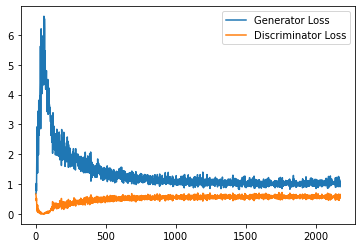

Step 44000: Generator loss: 1.0488029383420945, discriminator loss: 0.5764455085396767


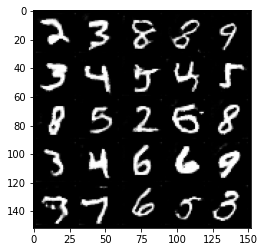

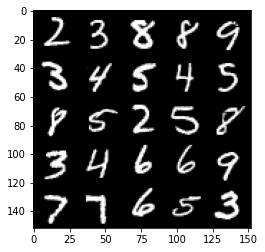

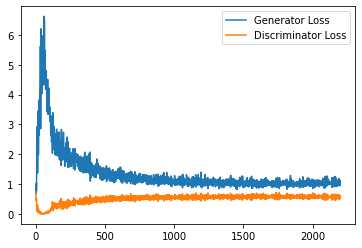

Step 44500: Generator loss: 1.0620747550725937, discriminator loss: 0.5726649333238601


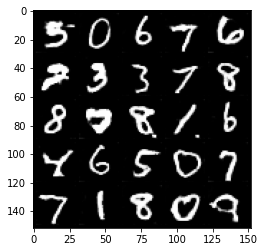

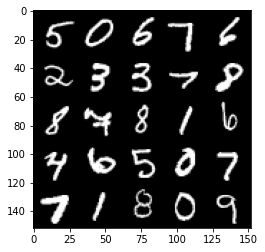

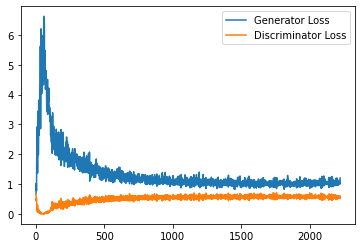

Step 45000: Generator loss: 1.0279768421649933, discriminator loss: 0.5794411871433258


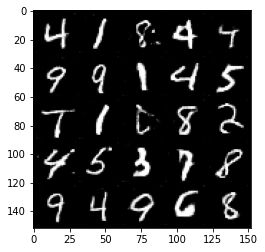

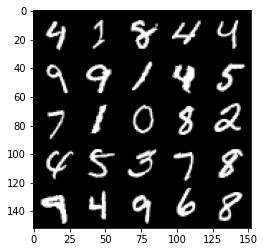

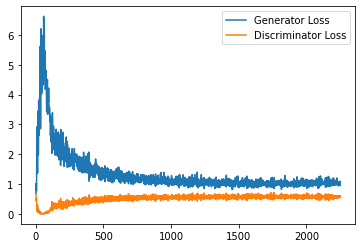

Step 45500: Generator loss: 1.0591608606576919, discriminator loss: 0.5733506301045418


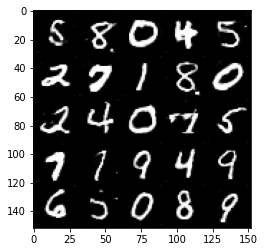

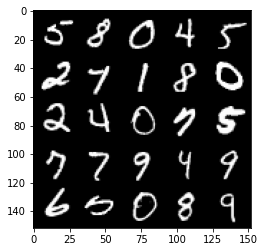

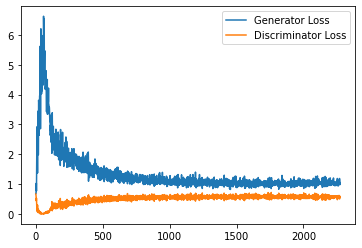

Step 46000: Generator loss: 1.0587804301977157, discriminator loss: 0.5730762767195702


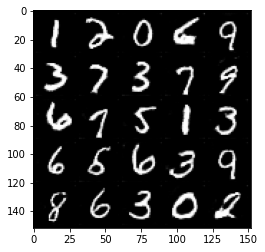

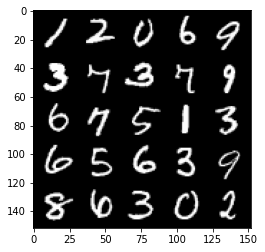

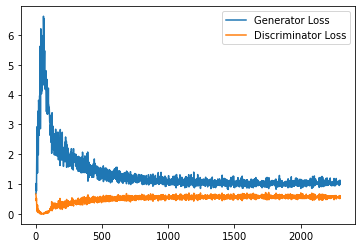

Step 46500: Generator loss: 1.0920134747028352, discriminator loss: 0.5768114993572235


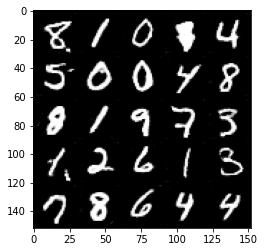

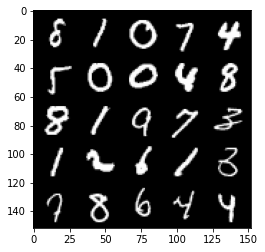

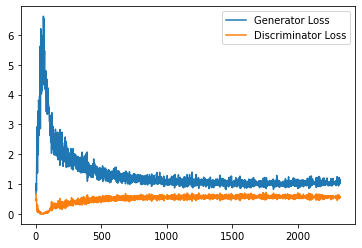

Step 47000: Generator loss: 1.0548816542625428, discriminator loss: 0.5748885112404823


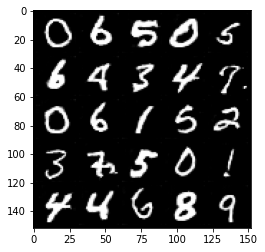

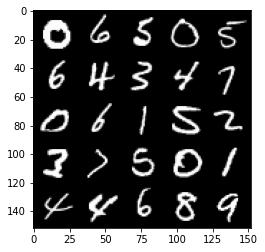

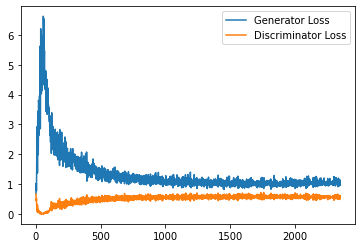

Step 47500: Generator loss: 1.0501259392499924, discriminator loss: 0.5680396724939346


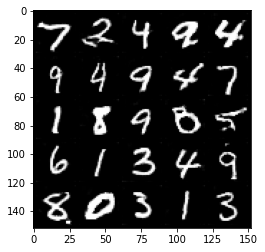

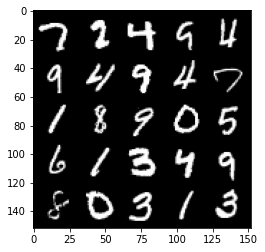

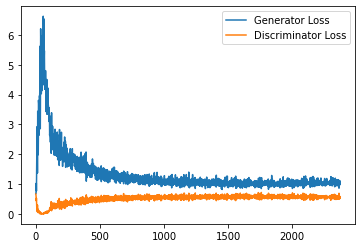

Step 48000: Generator loss: 1.066758238196373, discriminator loss: 0.569650884270668


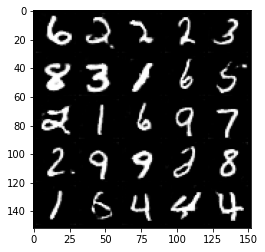

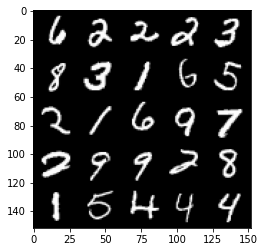

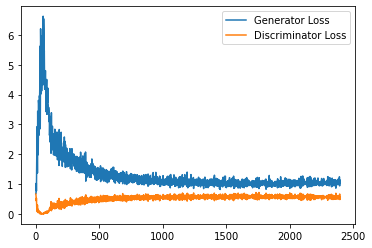

Step 48500: Generator loss: 1.0522562177181245, discriminator loss: 0.5846709995865822


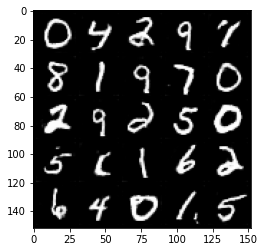

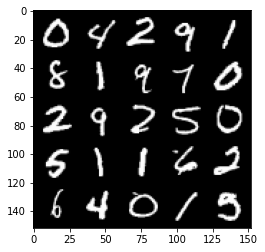

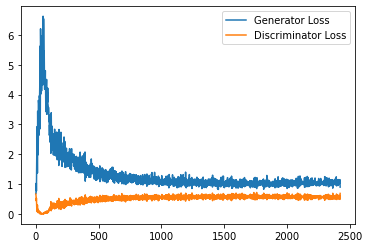

Step 49000: Generator loss: 1.0569884843230248, discriminator loss: 0.5853925185799599


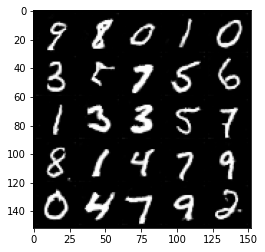

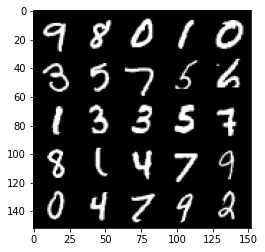

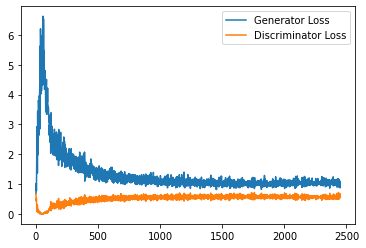

Step 49500: Generator loss: 1.0556524492502213, discriminator loss: 0.5740454691052437


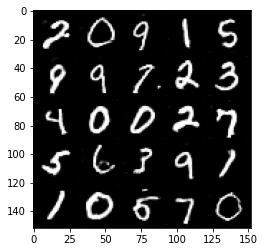

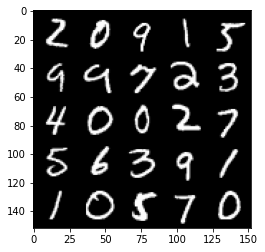

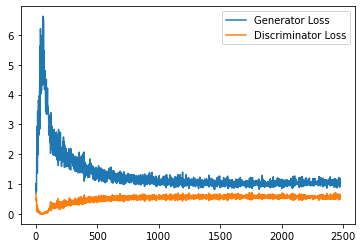

Step 50000: Generator loss: 1.0572452639341354, discriminator loss: 0.5769484155774116


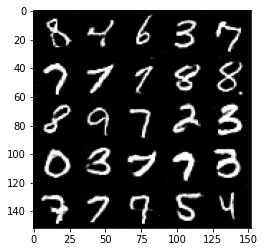

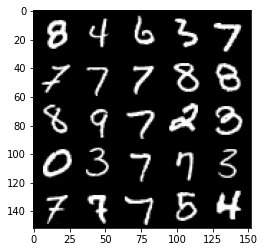

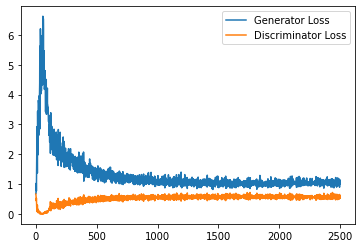

Step 50500: Generator loss: 1.0724067733287812, discriminator loss: 0.5748470513820648


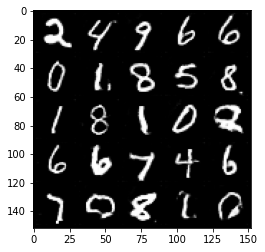

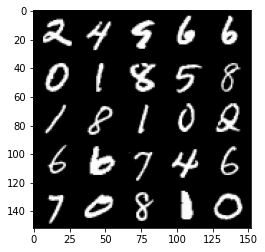

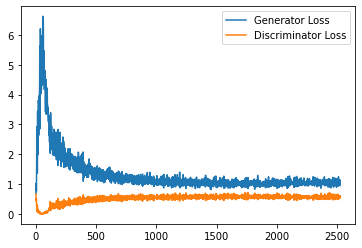

Step 51000: Generator loss: 1.0449293509721755, discriminator loss: 0.5733565480709076


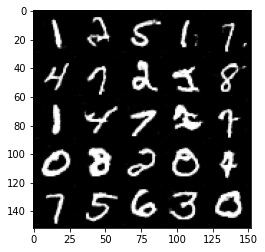

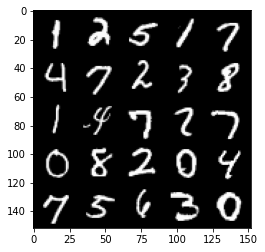

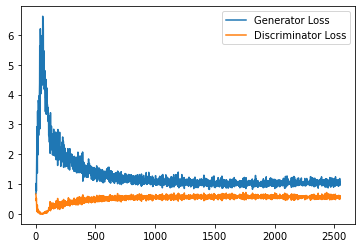

Step 51500: Generator loss: 1.0749145482778548, discriminator loss: 0.5664226829409599


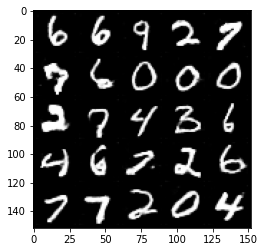

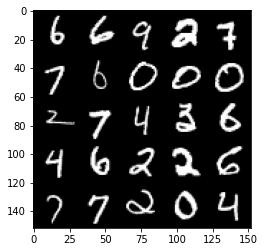

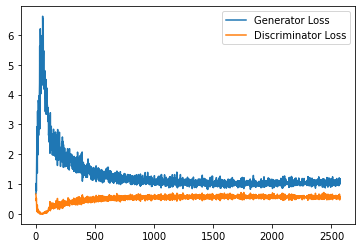

Step 52000: Generator loss: 1.0817142585515975, discriminator loss: 0.5714077309966087


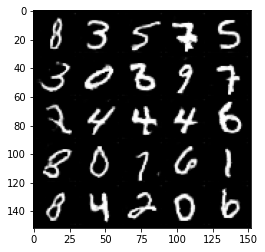

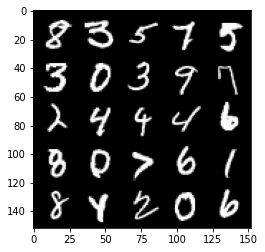

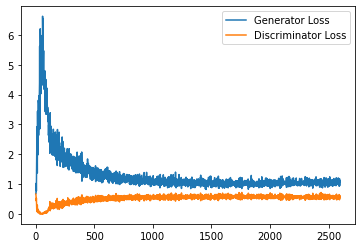

Step 52500: Generator loss: 1.0719403471946716, discriminator loss: 0.5722371576428413


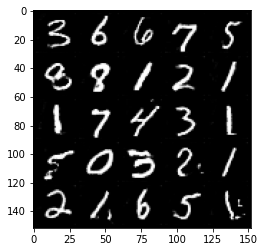

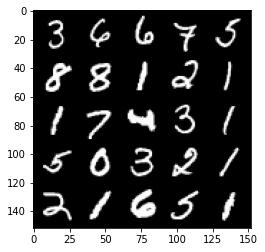

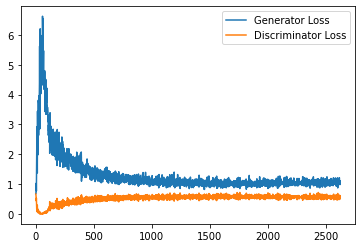

Step 53000: Generator loss: 1.0621414861679077, discriminator loss: 0.5708486687541008


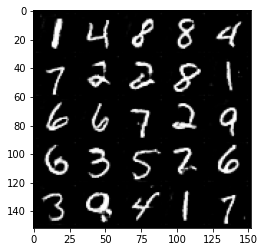

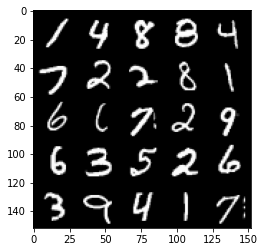

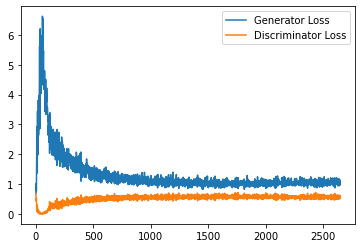

Step 53500: Generator loss: 1.0865720118284226, discriminator loss: 0.5655649219155312


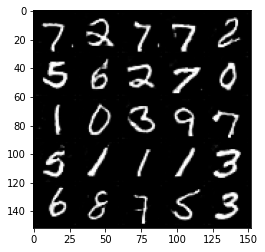

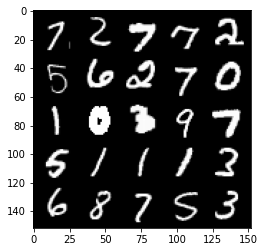

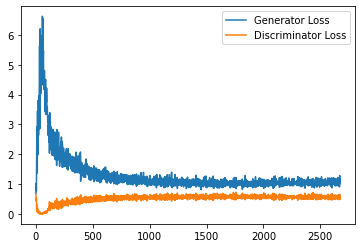

Step 54000: Generator loss: 1.0693451991081238, discriminator loss: 0.5701647503376007


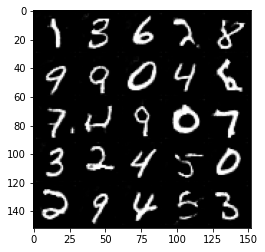

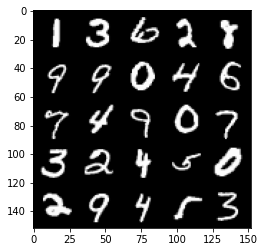

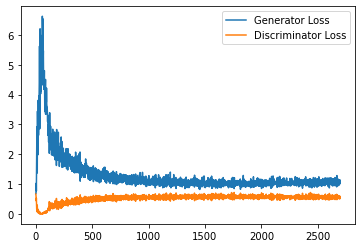

Step 54500: Generator loss: 1.0597173813581466, discriminator loss: 0.5748134793043137


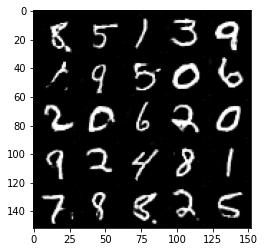

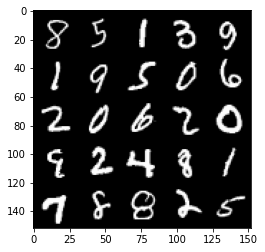

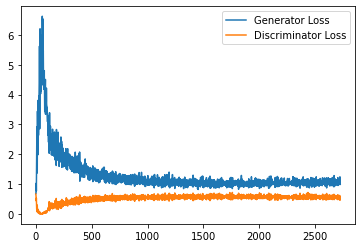

Step 55000: Generator loss: 1.0573786789178847, discriminator loss: 0.568245417535305


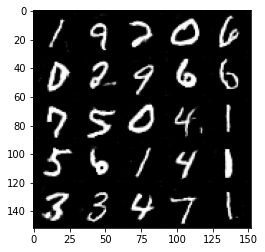

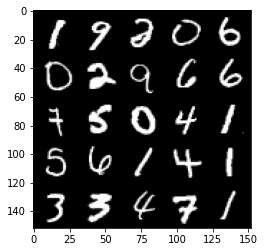

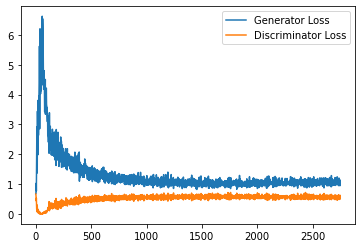

Step 55500: Generator loss: 1.0867219941616058, discriminator loss: 0.5741415687203407


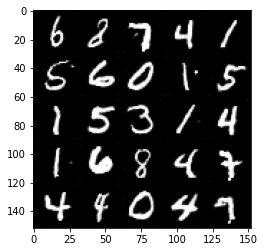

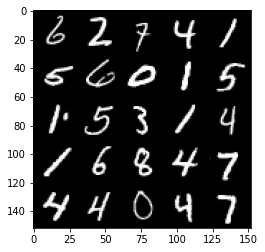

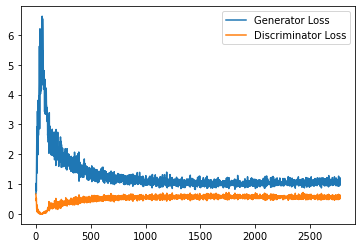

Step 56000: Generator loss: 1.0819039634466172, discriminator loss: 0.5744931967258453


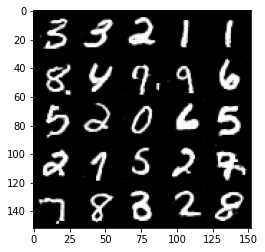

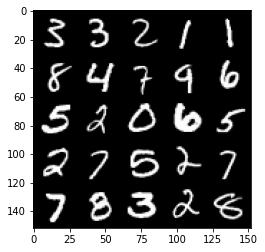

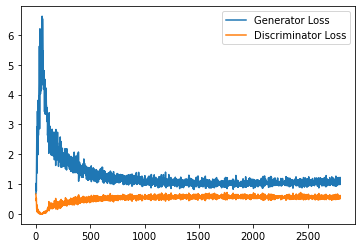

Step 56500: Generator loss: 1.068515761256218, discriminator loss: 0.56832252150774


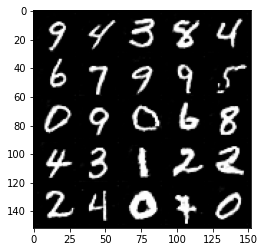

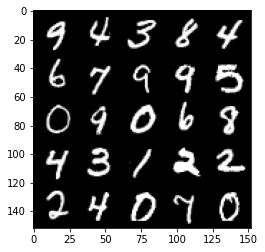

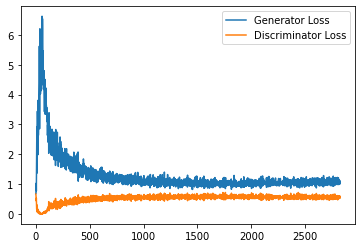

Step 57000: Generator loss: 1.0826479365825654, discriminator loss: 0.5654344983100891


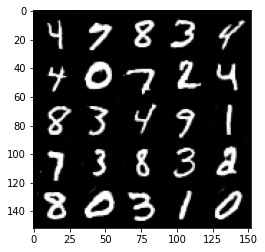

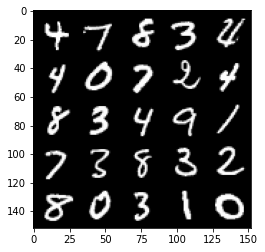

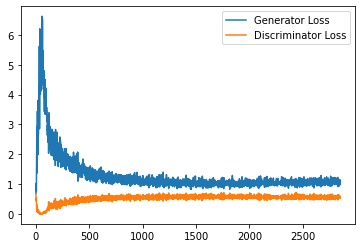

Step 57500: Generator loss: 1.074549201488495, discriminator loss: 0.5730640302300454


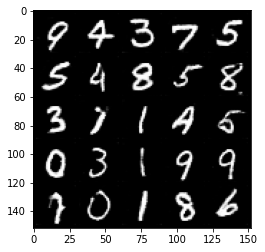

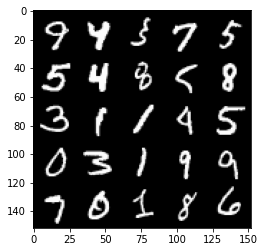

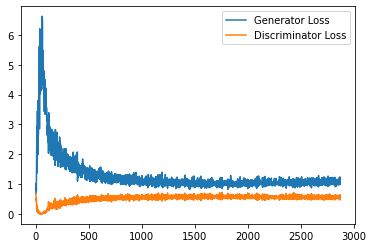

Step 58000: Generator loss: 1.0909208112955093, discriminator loss: 0.5657236124277115


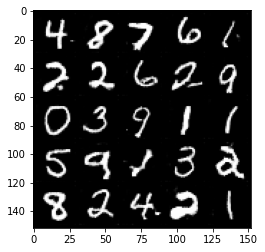

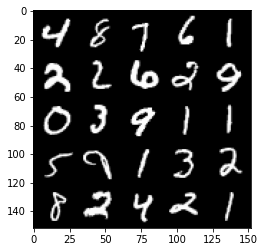

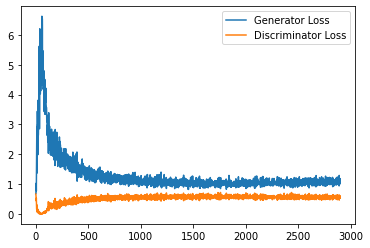

Step 58500: Generator loss: 1.1147428961992263, discriminator loss: 0.5670226849913597


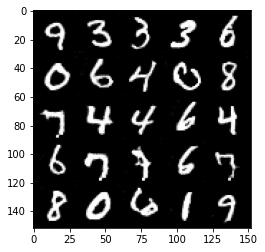

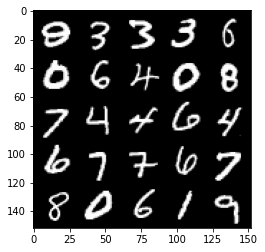

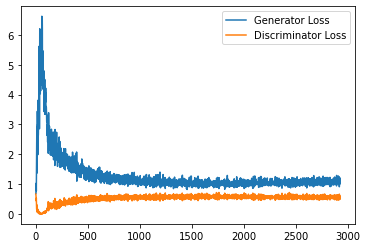

Step 59000: Generator loss: 1.0843384701013565, discriminator loss: 0.5690326780676842


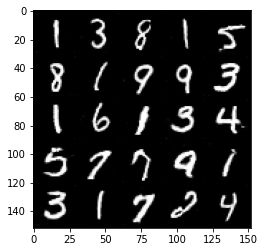

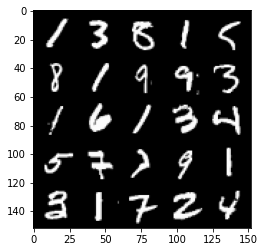

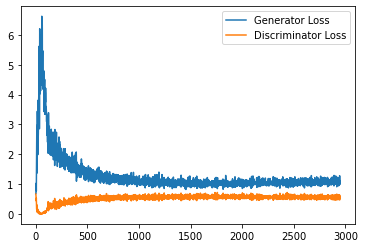

Step 59500: Generator loss: 1.0712612582445145, discriminator loss: 0.5677743071913719


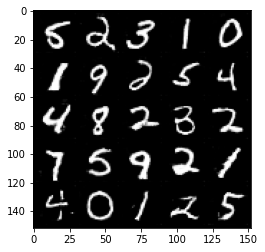

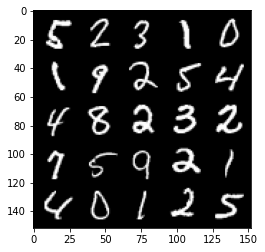

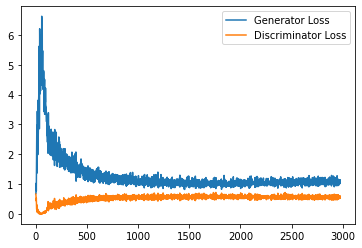

Step 60000: Generator loss: 1.0822903381586075, discriminator loss: 0.5779539443254471


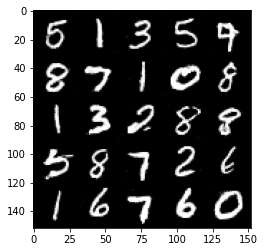

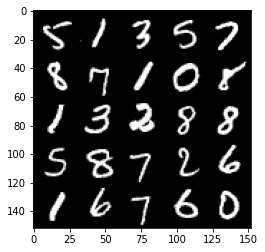

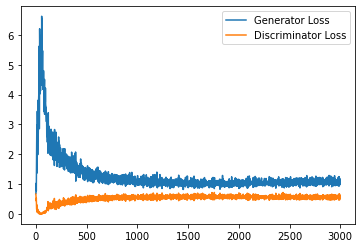

Step 60500: Generator loss: 1.0732799888849258, discriminator loss: 0.5663987902998924


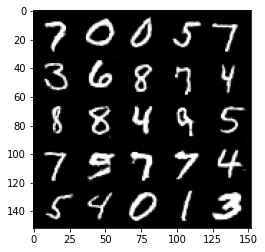

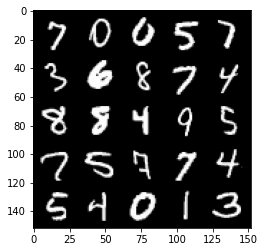

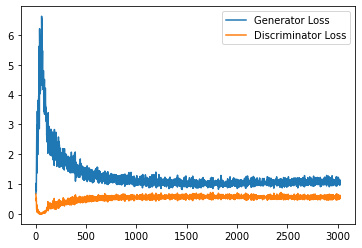

Step 61000: Generator loss: 1.093208443880081, discriminator loss: 0.5675488340258599


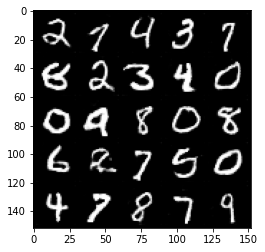

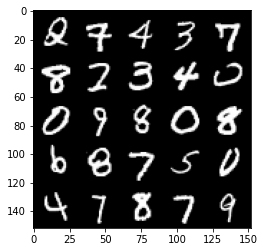

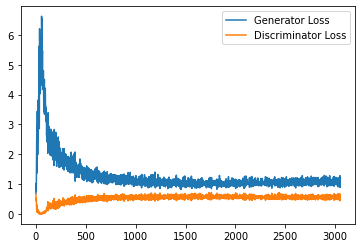

Step 61500: Generator loss: 1.0856202917098998, discriminator loss: 0.5708153530359268


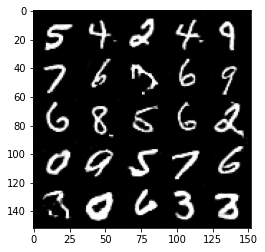

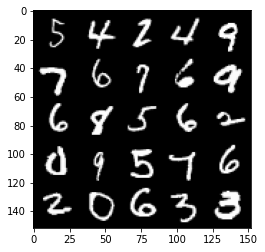

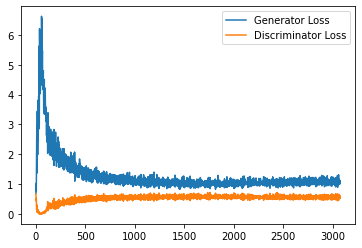

Step 62000: Generator loss: 1.0654032989740372, discriminator loss: 0.5708777945637703


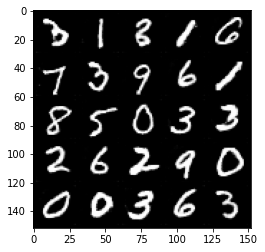

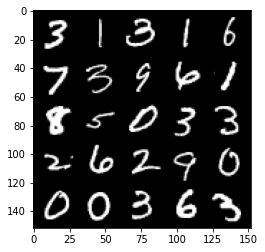

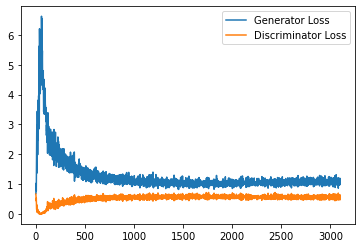

Step 62500: Generator loss: 1.081409427881241, discriminator loss: 0.5722336844205856


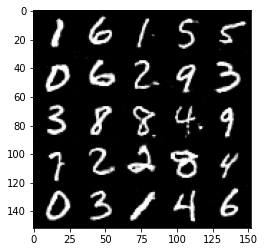

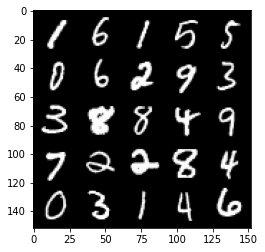

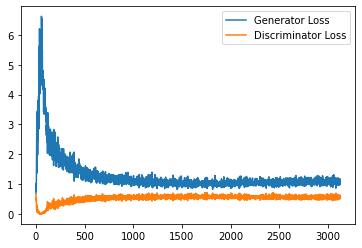

Step 63000: Generator loss: 1.0815834267139435, discriminator loss: 0.5695271967053414


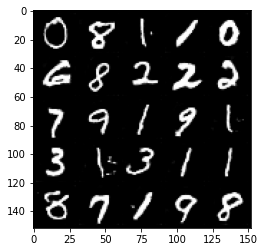

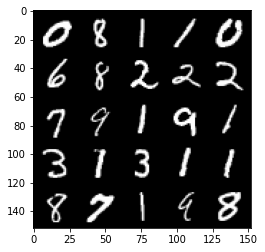

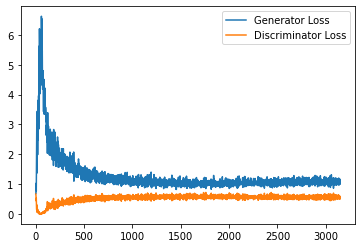

Step 63500: Generator loss: 1.073083899140358, discriminator loss: 0.5722625066637993


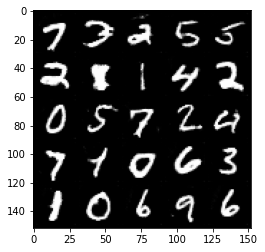

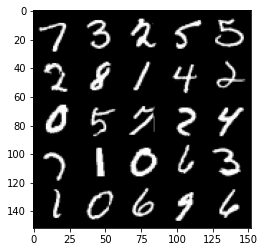

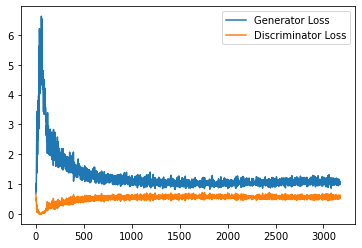

Step 64000: Generator loss: 1.0768087062835694, discriminator loss: 0.5684926761388779


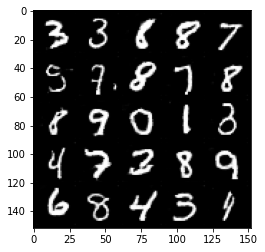

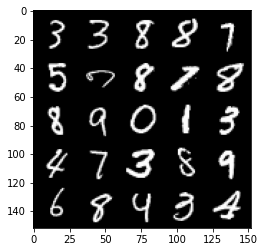

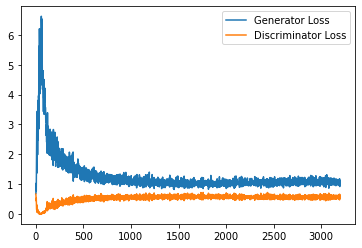

Step 64500: Generator loss: 1.0743113077878952, discriminator loss: 0.5757377910017967


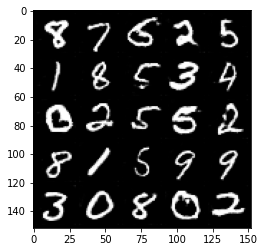

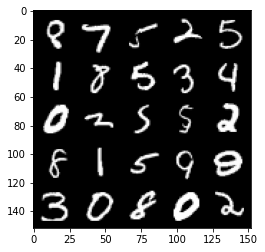

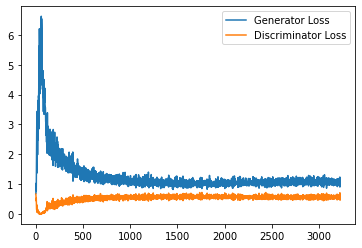

Step 65000: Generator loss: 1.0654579187631608, discriminator loss: 0.5775019147396088


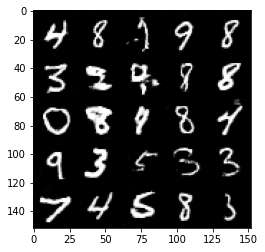

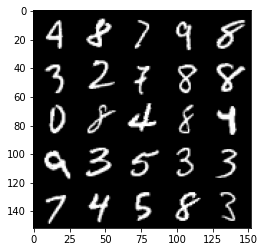

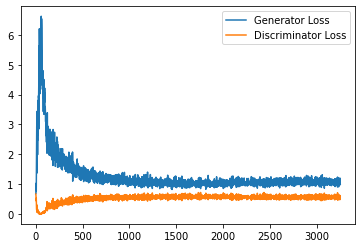

Step 65500: Generator loss: 1.0659910616874695, discriminator loss: 0.5745513991713523


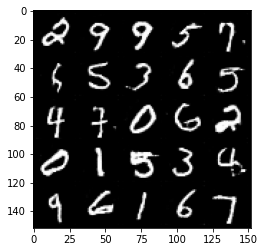

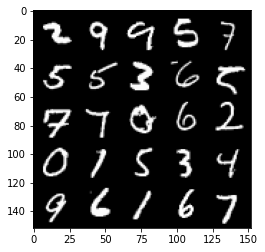

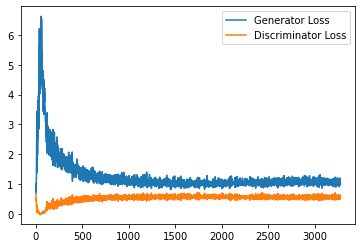

Step 66000: Generator loss: 1.0683743149042129, discriminator loss: 0.5767418407201766


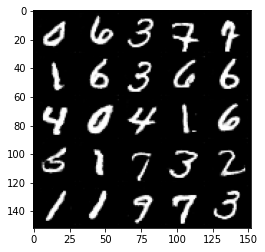

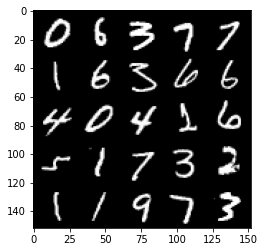

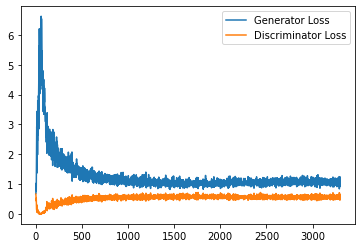

Step 66500: Generator loss: 1.0771950936317445, discriminator loss: 0.5663282795548439


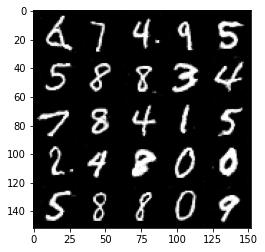

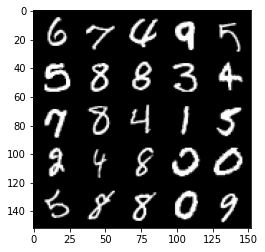

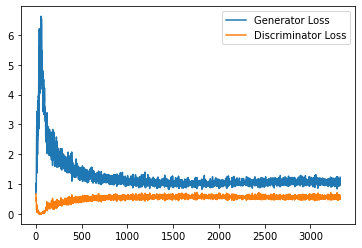

Step 67000: Generator loss: 1.086159213900566, discriminator loss: 0.569363141477108


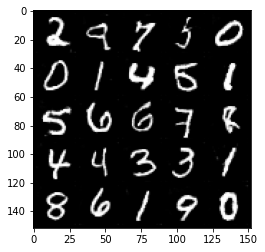

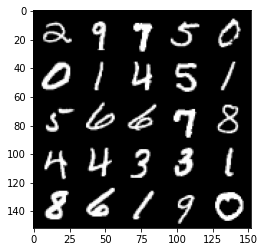

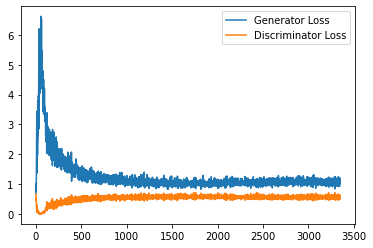

Step 67500: Generator loss: 1.066707645058632, discriminator loss: 0.5759005011916161


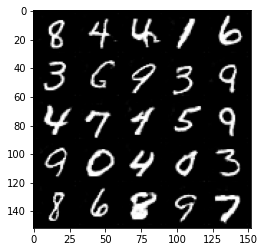

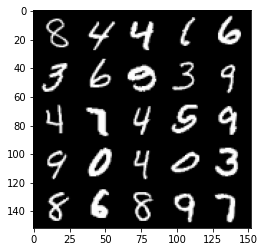

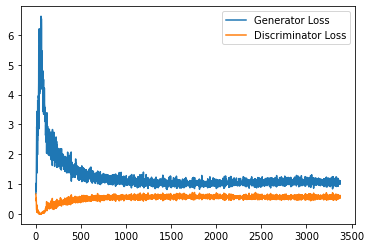

Step 68000: Generator loss: 1.067869135260582, discriminator loss: 0.5738262021541596


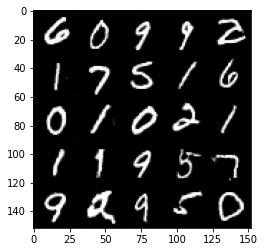

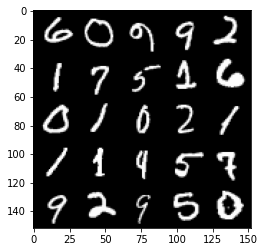

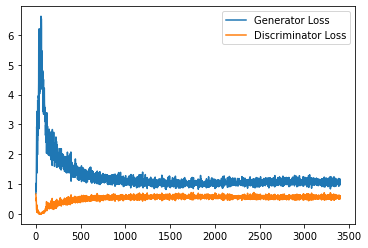

Step 68500: Generator loss: 1.0742240236997604, discriminator loss: 0.5739283627867698


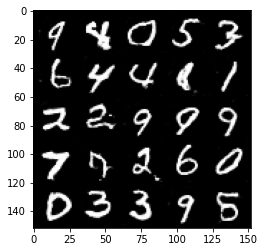

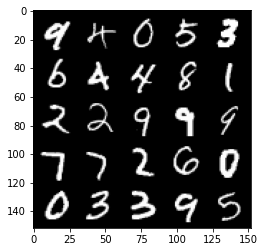

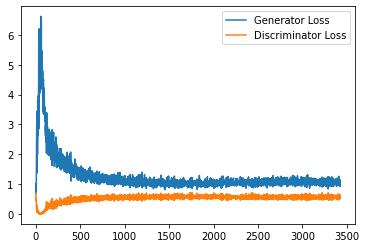

Step 69000: Generator loss: 1.0588446675539016, discriminator loss: 0.5807232181429863


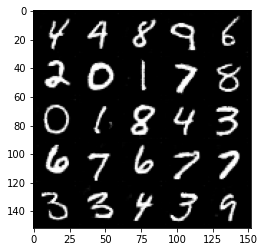

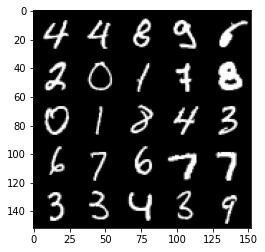

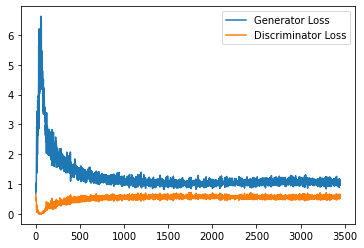

Step 69500: Generator loss: 1.0854965728521346, discriminator loss: 0.576955144584179


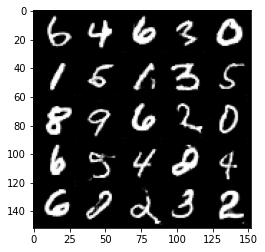

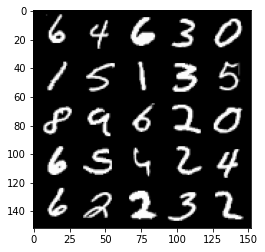

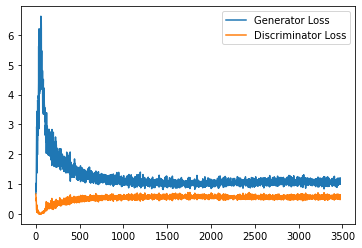

Step 70000: Generator loss: 1.0747404189109802, discriminator loss: 0.5794652788639069


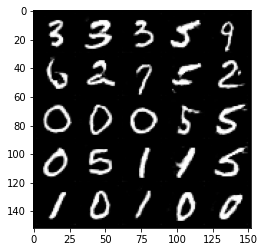

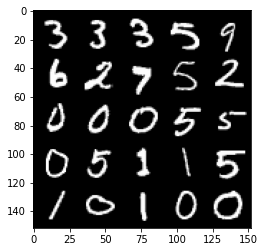

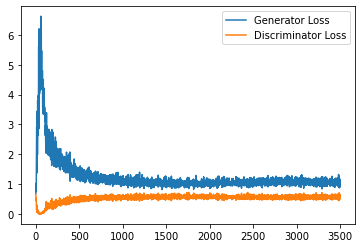

Step 70500: Generator loss: 1.062265041589737, discriminator loss: 0.5730941132903099


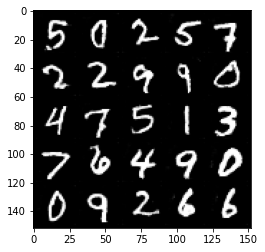

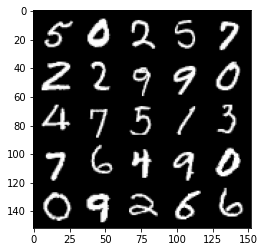

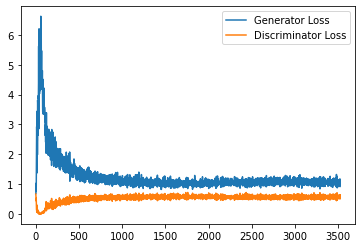

Step 71000: Generator loss: 1.067534833431244, discriminator loss: 0.5770680871009827


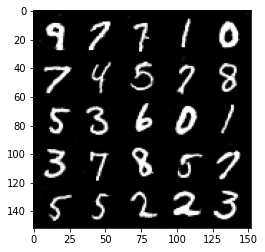

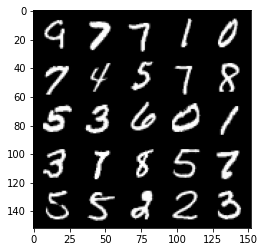

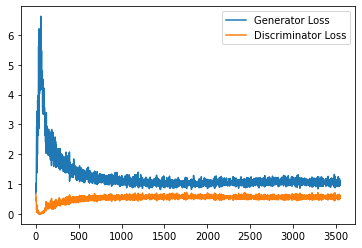

Step 71500: Generator loss: 1.0473234403133391, discriminator loss: 0.581976893723011


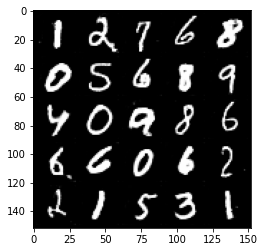

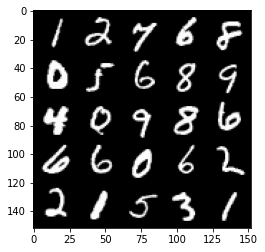

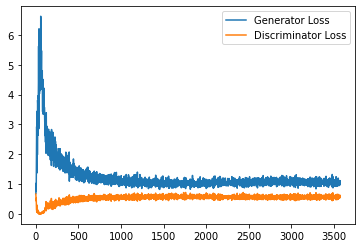

Step 72000: Generator loss: 1.0458509459495544, discriminator loss: 0.5791699659824371


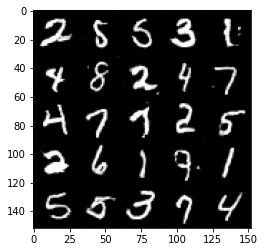

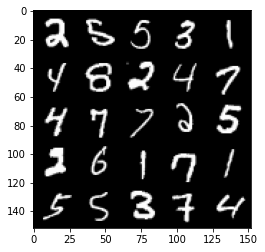

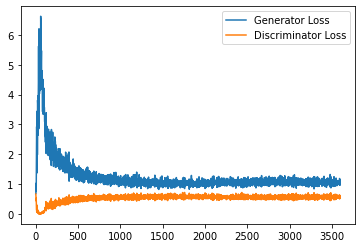

Step 72500: Generator loss: 1.0570045577287674, discriminator loss: 0.5797594166398048


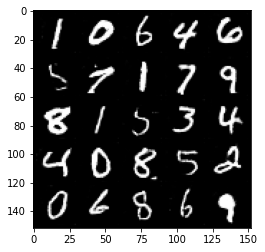

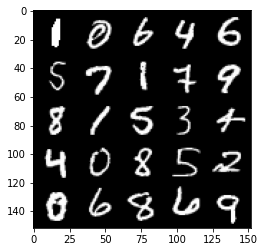

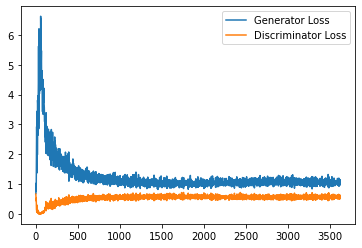

Step 73000: Generator loss: 1.055658852815628, discriminator loss: 0.582695644915104


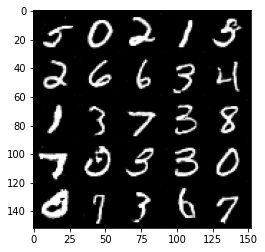

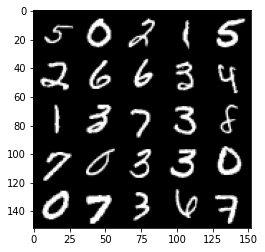

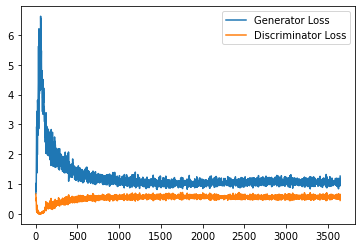

Step 73500: Generator loss: 1.0751865963935852, discriminator loss: 0.5890654131174088


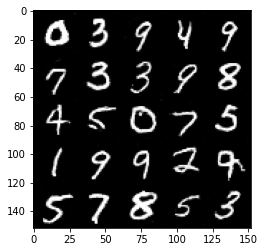

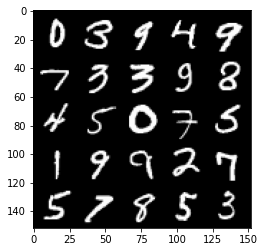

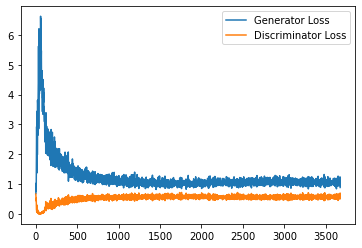

Step 74000: Generator loss: 1.05906135058403, discriminator loss: 0.5820911725759507


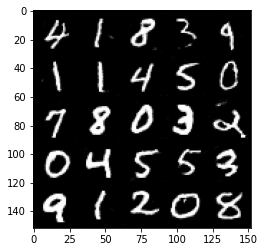

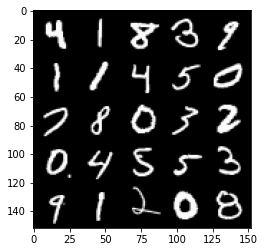

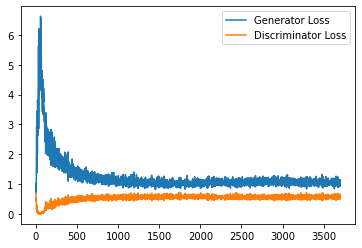

Step 74500: Generator loss: 1.0639426027536392, discriminator loss: 0.584470598757267


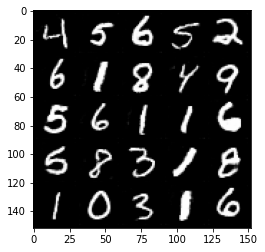

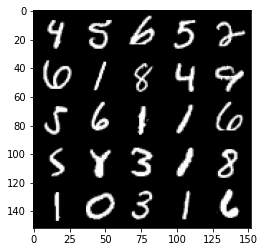

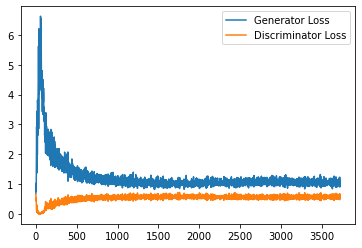

Step 75000: Generator loss: 1.0586880909204484, discriminator loss: 0.5805804697871209


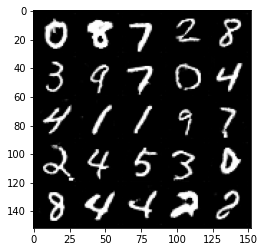

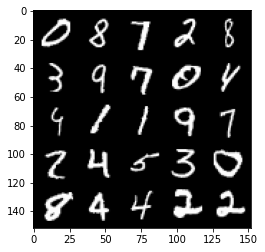

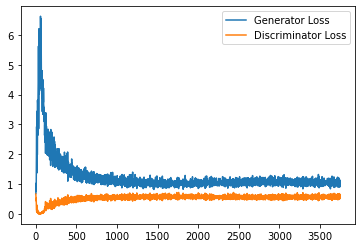

Step 75500: Generator loss: 1.0503736288547516, discriminator loss: 0.5870872718691826


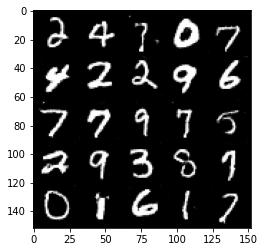

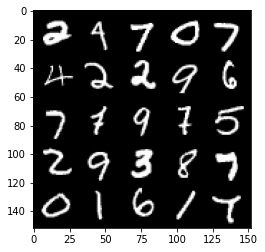

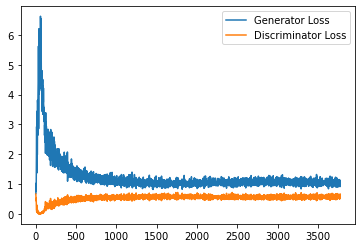

Step 76000: Generator loss: 1.0581797018051147, discriminator loss: 0.5829147230982781


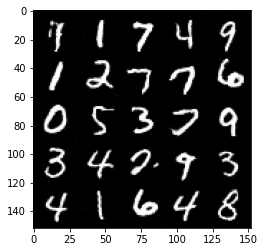

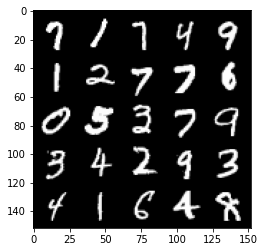

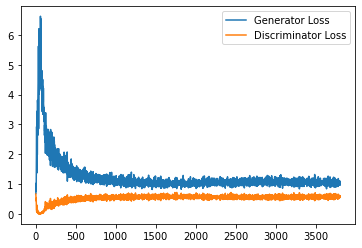

Step 76500: Generator loss: 1.0550821964740753, discriminator loss: 0.5832169976830482


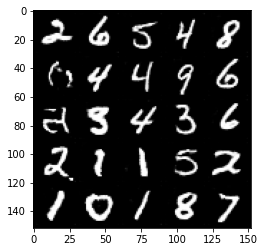

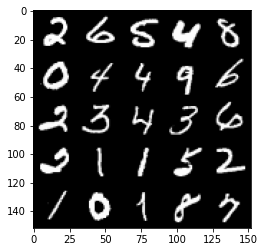

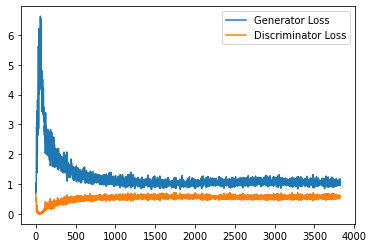

Step 77000: Generator loss: 1.0523566241264344, discriminator loss: 0.5822233401536941


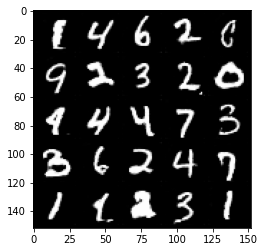

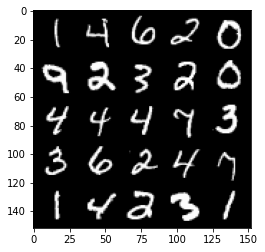

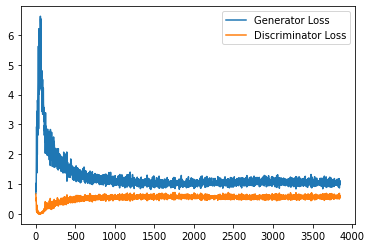

Step 77500: Generator loss: 1.0654624369144439, discriminator loss: 0.5826065363883972


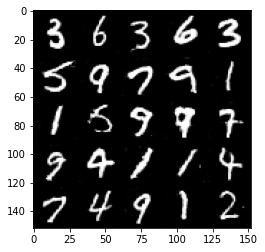

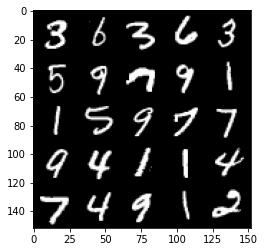

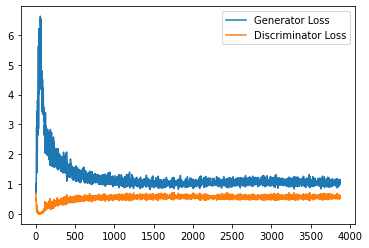

Step 78000: Generator loss: 1.0615002006292342, discriminator loss: 0.5813131905794143


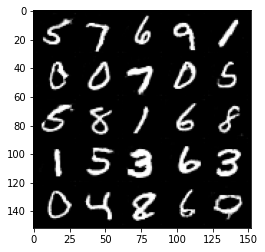

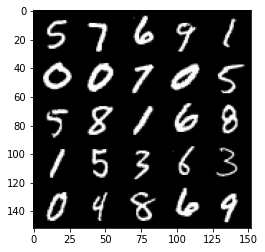

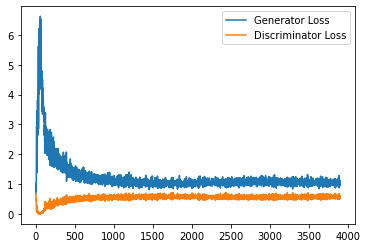

Step 78500: Generator loss: 1.051335139632225, discriminator loss: 0.5881911380887032


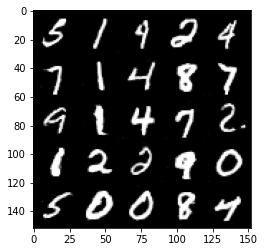

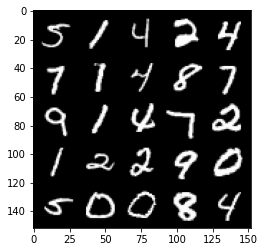

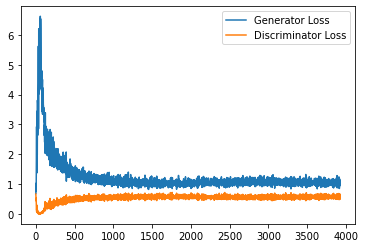

Step 79000: Generator loss: 1.051861497104168, discriminator loss: 0.5859878761172295


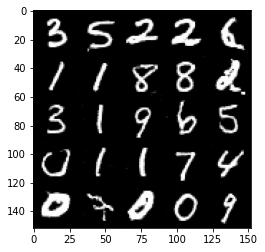

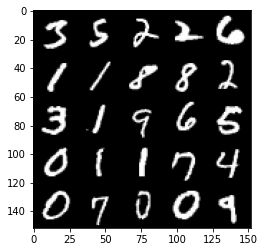

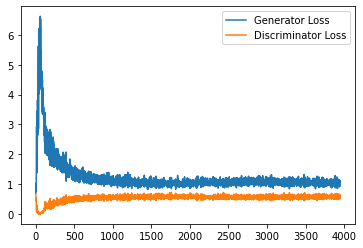

Step 79500: Generator loss: 1.0528033972978592, discriminator loss: 0.5888377333283424


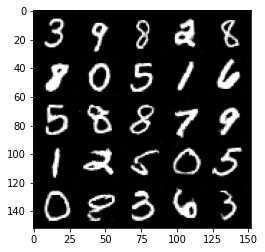

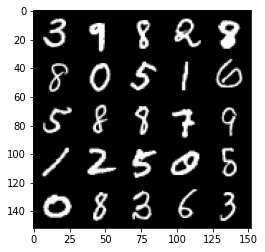

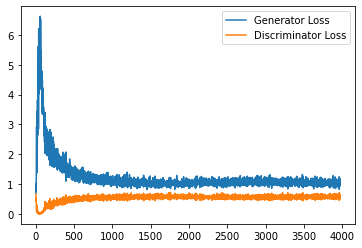

Step 80000: Generator loss: 1.0488016111850738, discriminator loss: 0.5815860453248024


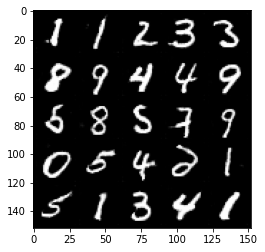

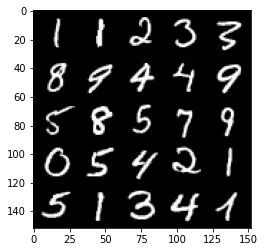

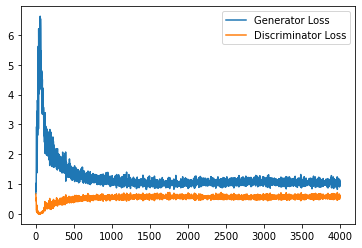

Step 80500: Generator loss: 1.0503909760713577, discriminator loss: 0.5884488651752472


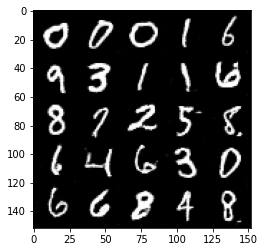

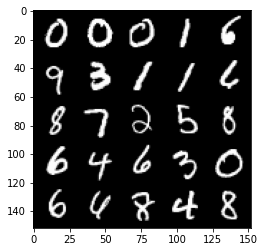

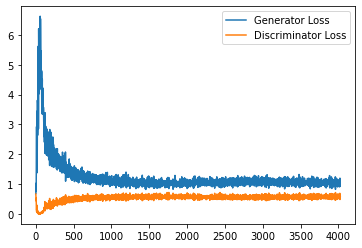

Step 81000: Generator loss: 1.0531238404512406, discriminator loss: 0.5832977797985077


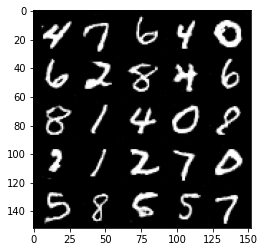

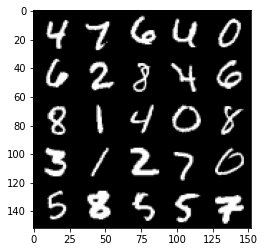

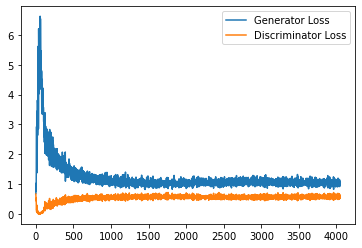

Step 81500: Generator loss: 1.0571517025232315, discriminator loss: 0.589369914829731


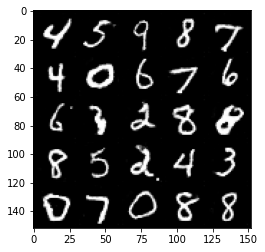

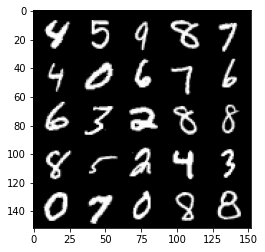

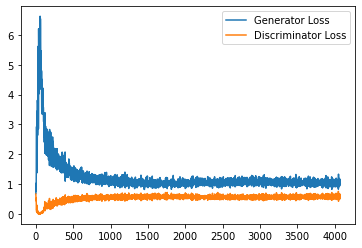

Step 82000: Generator loss: 1.0467095450162887, discriminator loss: 0.5824115745425225


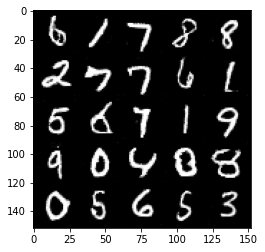

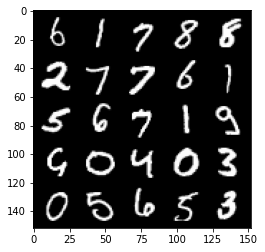

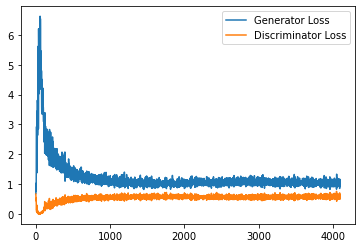

Step 82500: Generator loss: 1.0533088878393173, discriminator loss: 0.5833783066868782


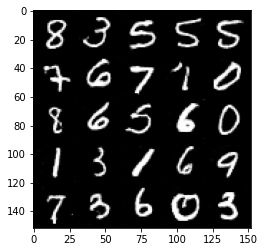

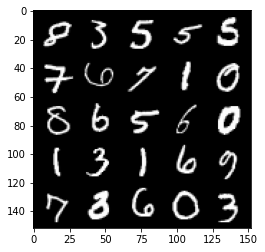

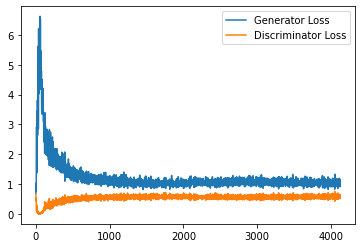

Step 83000: Generator loss: 1.0482790433168412, discriminator loss: 0.5893673402667046


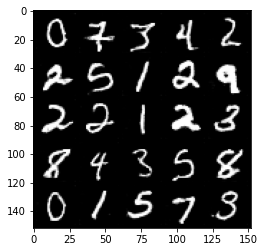

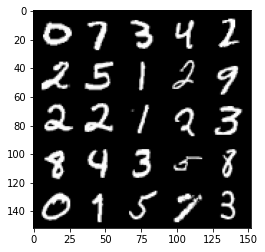

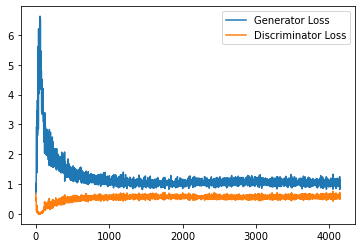

Step 83500: Generator loss: 1.0450913861989974, discriminator loss: 0.5812559363245964


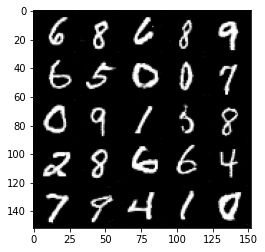

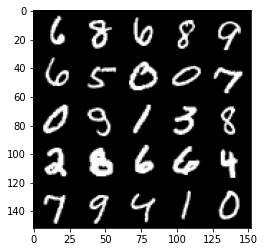

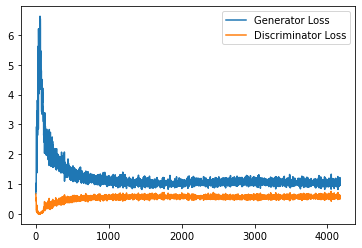

Step 84000: Generator loss: 1.0678696632385254, discriminator loss: 0.587556954562664


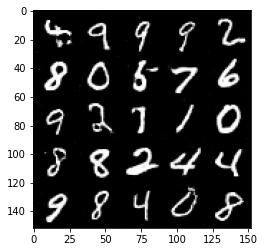

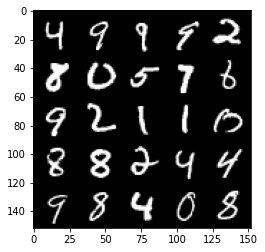

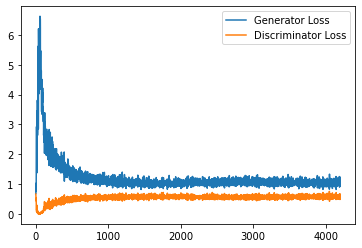

Step 84500: Generator loss: 1.0469231394529344, discriminator loss: 0.5852294462323189


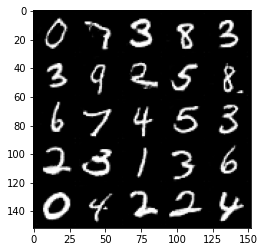

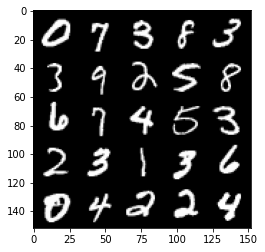

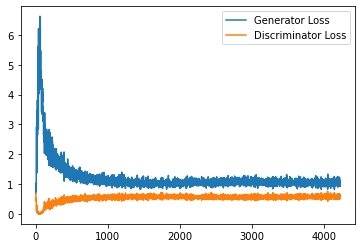

Step 85000: Generator loss: 1.0497340537309647, discriminator loss: 0.5876547905802727


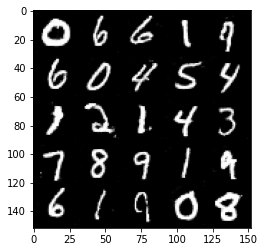

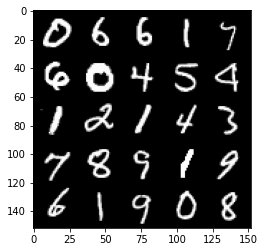

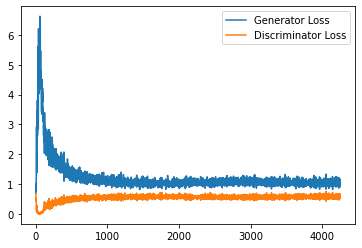

Step 85500: Generator loss: 1.0354662228822709, discriminator loss: 0.587709115087986


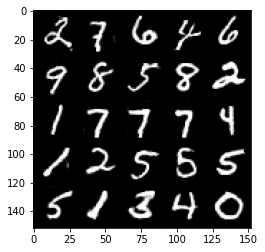

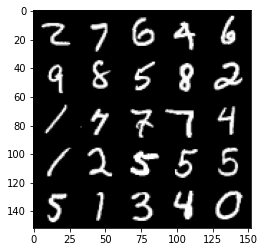

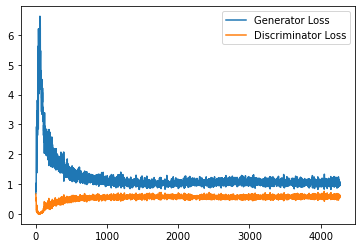

Step 86000: Generator loss: 1.0460571525692939, discriminator loss: 0.5843187376856804


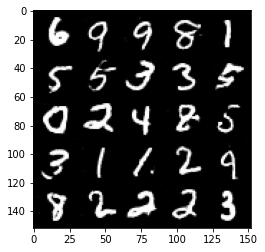

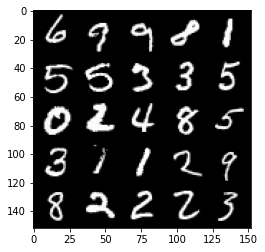

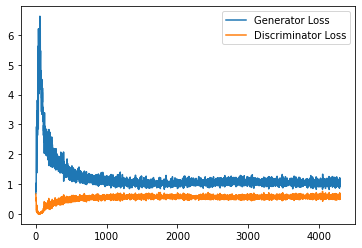

Step 86500: Generator loss: 1.0524416482448578, discriminator loss: 0.5908114829659462


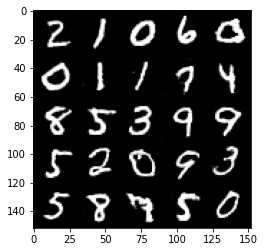

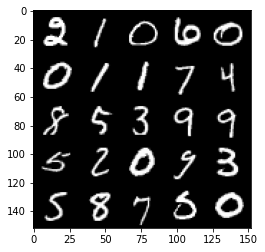

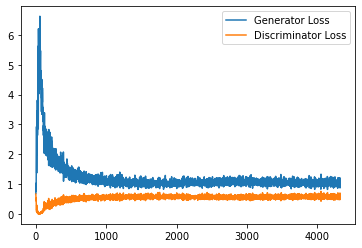

Step 87000: Generator loss: 1.0617898012399674, discriminator loss: 0.5888603271245957


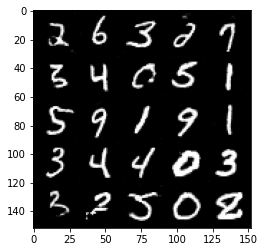

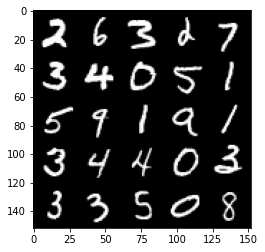

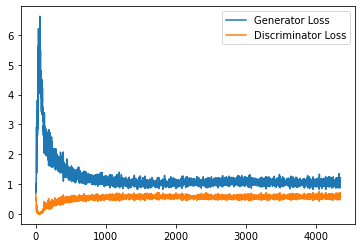

Step 87500: Generator loss: 1.0372171345949173, discriminator loss: 0.5865614656209945


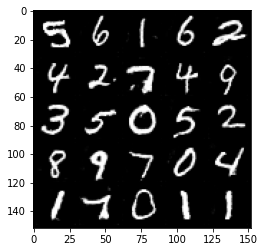

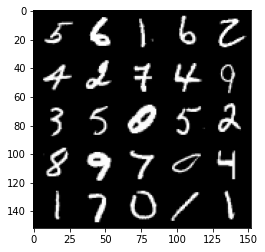

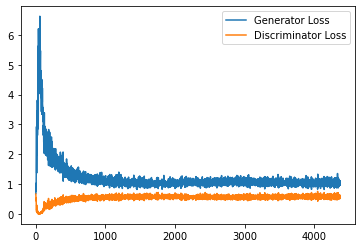

Step 88000: Generator loss: 1.0478899344205856, discriminator loss: 0.5902329816818237


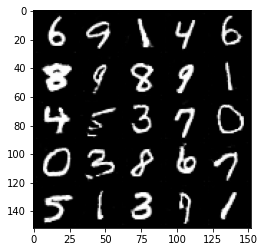

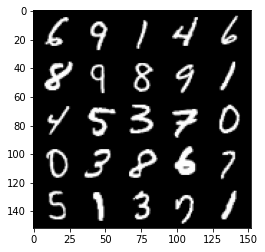

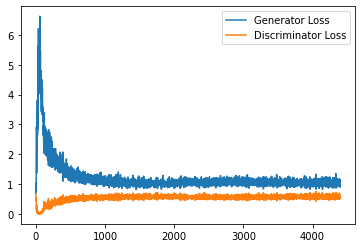

Step 88500: Generator loss: 1.0256561912298203, discriminator loss: 0.5886454638838768


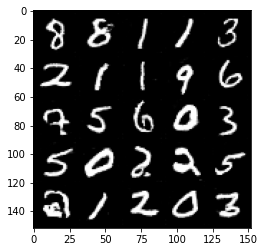

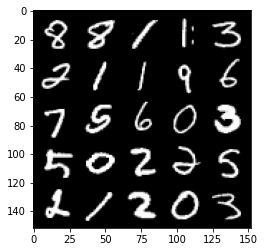

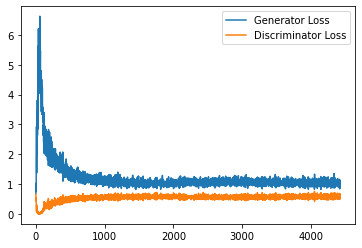

Step 89000: Generator loss: 1.0425259034633636, discriminator loss: 0.5839890568852425


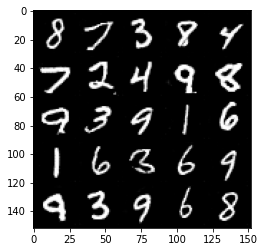

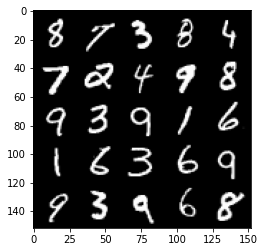

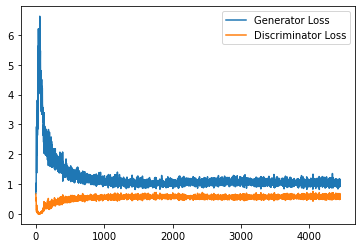

Step 89500: Generator loss: 1.03996526491642, discriminator loss: 0.5895321799516677


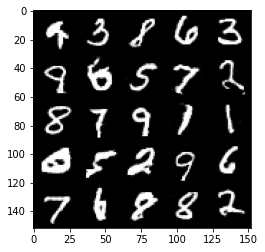

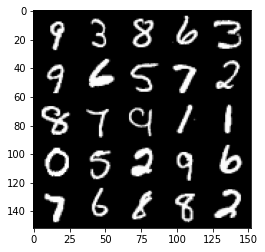

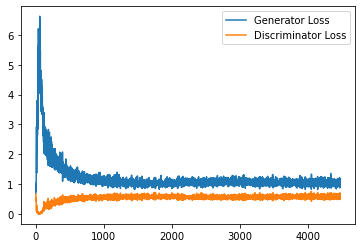

Step 90000: Generator loss: 1.0309996769428253, discriminator loss: 0.5903996688723564


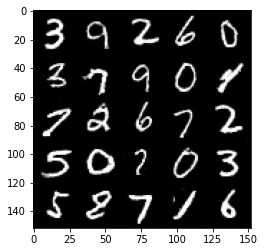

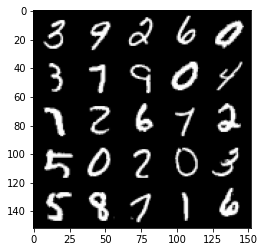

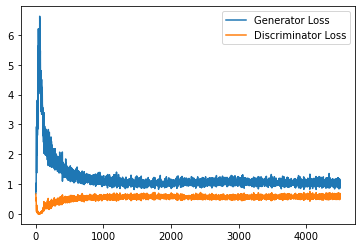

Step 90500: Generator loss: 1.0654601088762283, discriminator loss: 0.5885683353543282


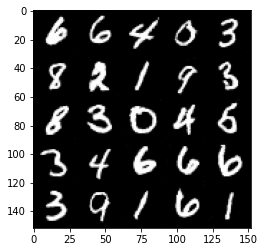

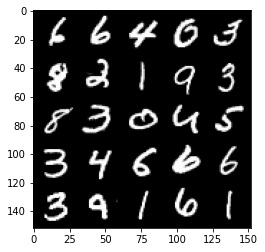

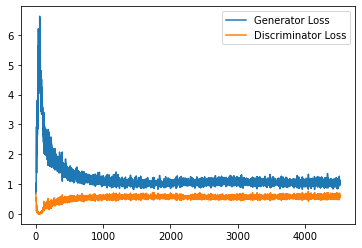

Step 91000: Generator loss: 1.0310066224336625, discriminator loss: 0.5910235769152641


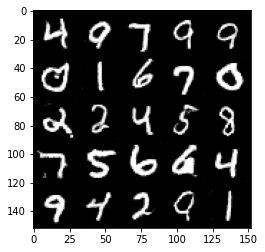

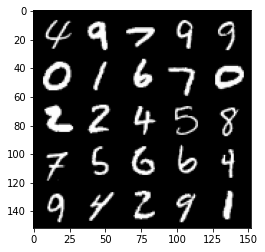

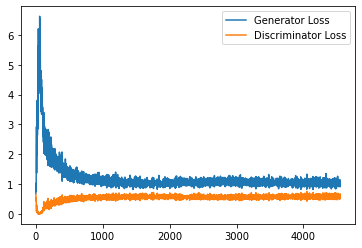

Step 91500: Generator loss: 1.0354878767728806, discriminator loss: 0.5925212334394455


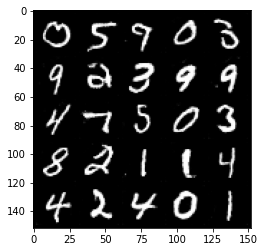

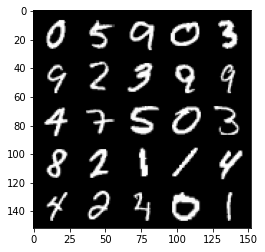

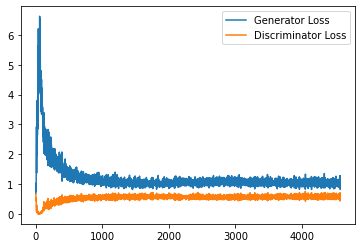

Step 92000: Generator loss: 1.0390593069791794, discriminator loss: 0.5856513758897781


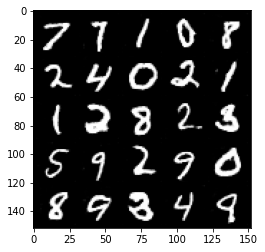

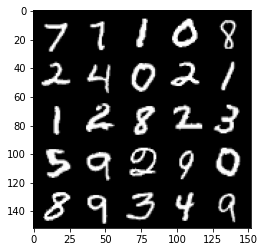

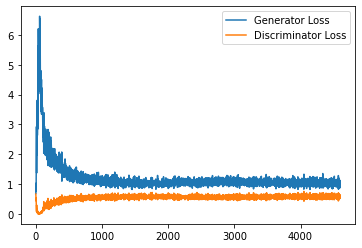

Step 92500: Generator loss: 1.0501558682918548, discriminator loss: 0.5857331666946411


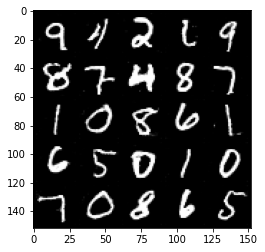

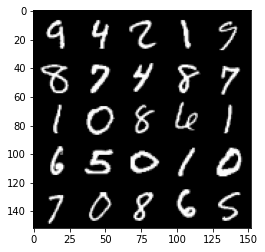

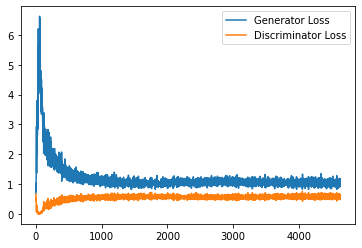

Step 93000: Generator loss: 1.049932601094246, discriminator loss: 0.5899650451540946


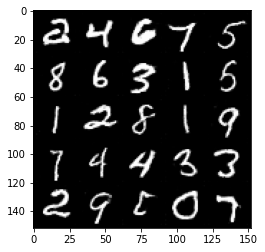

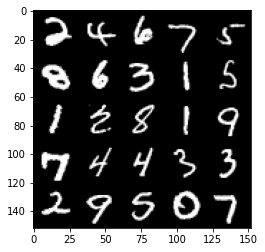

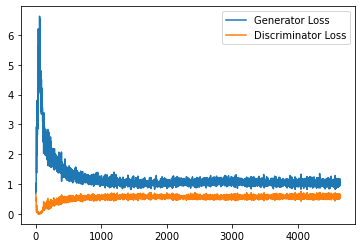

Step 93500: Generator loss: 1.0475858483314515, discriminator loss: 0.5932323837280273


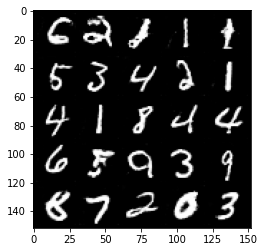

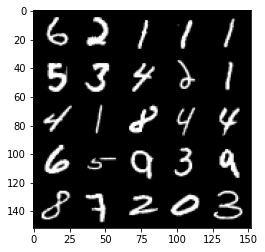

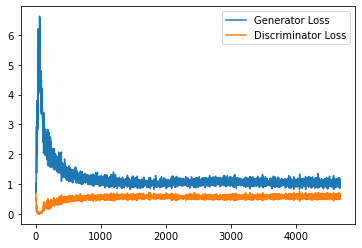

In [ ]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen.forward(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)

        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [ ]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

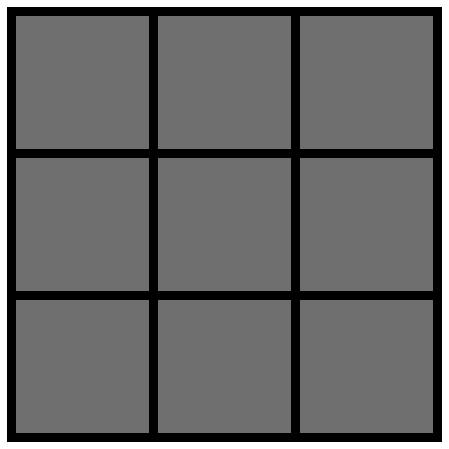

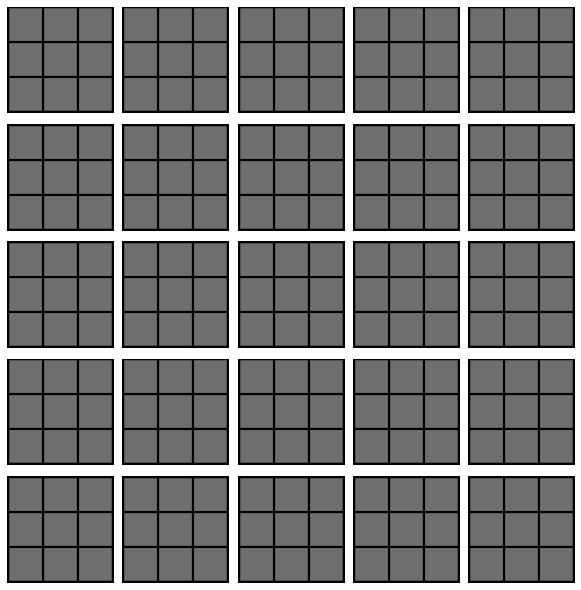

In [ ]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))
for i, first_plot_number in enumerate(plot_numbers):
    for j, second_plot_number in enumerate(plot_numbers):
        plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
        interpolate_class(first_plot_number, second_plot_number)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

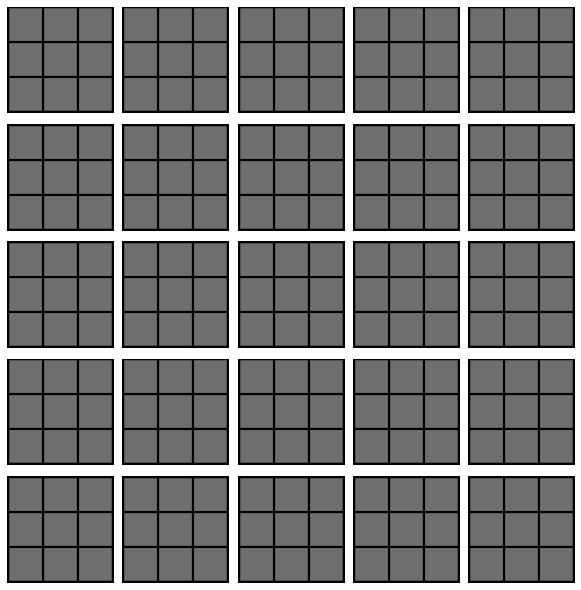

In [14]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()